In [3]:
"""
R001_Fall_2023_AI_Reproducibility__
|
R001_Extract_Citing_Paper_Details_from_S2GA.ipynb
Created on Thu Sep 21 14:36:12 2023
@author: Rochana Obadage
"""

'\nR001_Fall_2023_AI_Reproducibility__\n|\nR001_Extract_Citing_Paper_Details_from_S2GA.ipynb\nCreated on Thu Sep 21 14:36:12 2023\n@author: Rochana Obadage\n'

In [2]:
# !pip list

!python --version

Python 3.9.13


# ``Extract citing paper details from Semantic Scholar Graph API (S2GA)`` 

### `dependencies`
> <font face="consolas" color='#000080'><b>1. python:</b><br> 
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;3.8.17&emsp;&emsp;|&emsp;&emsp;3.9.13<br><br>
<b>2. Jupyter Notebook:</b><br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;notebook server: 6.5.4<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;Kernel Information: Python 3.8.17 (default, Jul  5 2023, 20:44:21) [MSC v.1916 64 bit (AMD64)]<br><br>
<b>3. conda installations:</b><br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;pandas==2.0.3<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;Beatifulsoup4==4.11.1<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;Selenium==4.11.2<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;conda install -c conda-forge selenium<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;webdriver-manager=4.0.0<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;conda install -c conda-forge webdriver-manager<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;bibtexparser-1.4.0<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;conda install -c conda-forge bibtexparser!<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;pdfminer.six-20221105<br>
    &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;conda install -c conda-forge pdfminer.six<br>

</font>


In [1]:
from bs4 import BeautifulSoup, NavigableString, Tag

from selenium import webdriver 
from selenium.webdriver.common.by import By 
from selenium.webdriver.chrome.service import Service as ChromeService 
from webdriver_manager.chrome import ChromeDriverManager 
from selenium.webdriver.common.action_chains import ActionChains

import pandas as pd
import requests
import json
import urllib
import time
import string
import os
import shutil
import math
import json
import glob

import numpy as np
import matplotlib.pyplot as plt

import bibtexparser

from bibtexparser.bparser import BibTexParser
from bibtexparser.customization import convert_to_unicode

from pdfminer.high_level import extract_pages

## ``DOI pre processing``

In [9]:
df_doi = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")


pd.set_option('display.max_columns', None)
df_doi.head(10)

,key_for_all_RS,title_rs,authors_rs,article_type,keywords,abstract,pdf_url_rs,code_url_rs,org_paper_url,doi_rs,code_doi_rs,doi_org,venue_name_rs,challenge_year_rs,review_url_rs,journal_rs,volume_journal_rs,issue_journal_rs,published_year_journal_rs,domain,entry_type,rs_score,rs_score_comment,rs_comment
0,RS_001_MLRC_2022_01,[Re] $\mathcal{G}$-Mixup: Graph Data Augmentat...,"['Ermin Omeragic', 'Vuk ÄuranoviÄ‡']",Replication,"['rescience c', 'machine learning', 'data augm...",Scope of Reproducibility\nThis paper presents ...,/pdf/8c87cb1e84e1482826c40a3b0c43928eaef747f3.pdf,NaN,https://proceedings.mlr.press/v162/han22c.html,https://www.doi.org/10.5281/zenodo.8173650,NaN,https://doi.org/10.48550/arXiv.2202.07179,MLRC,2022,https://openreview.net/forum?id=XxUIomN-ndH,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.5,NaN,Results — Due to many missing implementation d...
1,RS_002_MLRC_2022_02,[Re] Exact Feature Distribution Matching for A...,"['Mert Erkol', 'Furkan KÄ±nlÄ±', 'BarÄ±ÅŸ Ã–zc...",Replication,"['feature distribution matching', 'style trans...",Reproducibility Summary:\n\nIn this reproducib...,/pdf/7bcb577c2a46db29c48234a5b72368053c7ebed3.pdf,NaN,https://openaccess.thecvf.com/content/CVPR2022...,https://www.doi.org/10.5281/zenodo.8173652,NaN,10.1109/CVPR52688.2022.00787,MLRC,2022,https://openreview.net/forum?id=a5_hbZf0NB&not...,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We have reproduced the experiments d...
2,RS_003_MLRC_2022_03,[Re] End-to-end Algorithm Synthesis with Recur...,"['Sean Michael McLeish', 'Long Tran-Thanh']",Replication,"['rescience c', 'Algorithmic Reasoning', 'Deep...","Scope of Reproducibility:\nIn this report, we ...",/pdf/07d5d68b5873d779bd1fd8c95b9767cb57fe0bc4.pdf,NaN,https://arxiv.org/pdf/2202.05826.pdf,https://www.doi.org/10.5281/zenodo.8173654,NaN,https://doi.org/10.48550/arXiv.2202.05826,MLRC,2022,https://openreview.net/forum?id=WaZB4pUVTi,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We verify the authors’ claims by rep...
3,RS_004_MLRC_2022_04,[Re] Label-Free Explainability for Unsupervise...,"['Eric Langezaal', 'Jesse Belleman', 'Joeri No...",Replication,"['Reproducibility', 'label-free', 'unsupervise...",Scope of Reproducibility â€” This study is an ...,/pdf/7fde4f12c675150699fc376cd097d5b9dad0b4d4.pdf,NaN,https://proceedings.mlr.press/v162/crabbe22a.html,https://www.doi.org/10.5281/zenodo.8173656,NaN,https://doi.org/10.48550/arXiv.2203.01928,MLRC,2022,https://openreview.net/forum?id=bBVZ3pY4z8p,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We find that the three main claims o...
4,RS_005_MLRC_2022_05,[Re] Exploring the Representation of Word Mean...,"['Matteo Brivio', 'Cagri Coltekin']",Replication,"['BERT', 'fastText', 'embeddings', 'language m...",This report summarizes our efforts to reproduc...,/pdf/78430c5af33bc892d852b49a5a6e93abeb314c6f.pdf,NaN,https://aclanthology.org/2021.acl-long.281/,https://www.doi.org/10.5281/zenodo.8173658,NaN,10.18653/v1/2021.acl-long.281,MLRC,2022,https://openreview.net/forum?id=Od5dD58libt,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We only manage to partially reproduc...
5,RS_006_MLRC_2022_06,[Re] Intriguing Properties of Contrastive Losses,"['Luca Marini', 'Mohamad Nabeel', 'Alexandre L...",Replication,"['self-supervised learning', 'contrastive lear...",Reproducibility Summary\n\nScope of Reproducib...,/pdf/fc591d20ed7c340bbe470789beb95d4cde81e7d5.pdf,NaN,https://proceedings.neurips.cc/paper/2021/hash...,https://www.doi.org/10.5281/zenodo.8173662,NaN,https://doi.org/10.48550/arXiv.2011.02803,MLRC,2022,https://openreview.net/forum?id=gb71irTNN7,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — The obtained linear evaluation accur...
6,RS_007_MLRC_2022_07,[Re] Bandit Theory and Thompson Sampling-guide...,['Luka Å½ontar'],Replication,"['Optimization', 'bandit learning', 'Thompson ...",The paper p

In [23]:
# DOI:10.1109/ICDAR.2017.192


# arXiv:1810.03023

# CorpusId:238531802

In [43]:
df_doi.insert(12, 's2ga_key', '')

In [44]:
df_doi.head(10)

,key_for_all_RS,title_rs,authors_rs,article_type,keywords,abstract,pdf_url_rs,code_url_rs,org_paper_url,doi_rs,code_doi_rs,doi_org,s2ga_key,venue_name_rs,challenge_year_rs,review_url_rs,journal_rs,volume_journal_rs,issue_journal_rs,published_year_journal_rs,domain,entry_type,rs_score,rs_score_comment,rs_comment
0,RS_001_MLRC_2022_01,[Re] $\mathcal{G}$-Mixup: Graph Data Augmentat...,"['Ermin Omeragic', 'Vuk ÄuranoviÄ‡']",Replication,"['rescience c', 'machine learning', 'data augm...",Scope of Reproducibility\nThis paper presents ...,/pdf/8c87cb1e84e1482826c40a3b0c43928eaef747f3.pdf,NaN,https://proceedings.mlr.press/v162/han22c.html,https://www.doi.org/10.5281/zenodo.8173650,NaN,https://doi.org/10.48550/arXiv.2202.07179,,MLRC,2022,https://openreview.net/forum?id=XxUIomN-ndH,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.5,NaN,Results — Due to many missing implementation d...
1,RS_002_MLRC_2022_02,[Re] Exact Feature Distribution Matching for A...,"['Mert Erkol', 'Furkan KÄ±nlÄ±', 'BarÄ±ÅŸ Ã–zc...",Replication,"['feature distribution matching', 'style trans...",Reproducibility Summary:\n\nIn this reproducib...,/pdf/7bcb577c2a46db29c48234a5b72368053c7ebed3.pdf,NaN,https://openaccess.thecvf.com/content/CVPR2022...,https://www.doi.org/10.5281/zenodo.8173652,NaN,10.1109/CVPR52688.2022.00787,,MLRC,2022,https://openreview.net/forum?id=a5_hbZf0NB&not...,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We have reproduced the experiments d...
2,RS_003_MLRC_2022_03,[Re] End-to-end Algorithm Synthesis with Recur...,"['Sean Michael McLeish', 'Long Tran-Thanh']",Replication,"['rescience c', 'Algorithmic Reasoning', 'Deep...","Scope of Reproducibility:\nIn this report, we ...",/pdf/07d5d68b5873d779bd1fd8c95b9767cb57fe0bc4.pdf,NaN,https://arxiv.org/pdf/2202.05826.pdf,https://www.doi.org/10.5281/zenodo.8173654,NaN,https://doi.org/10.48550/arXiv.2202.05826,,MLRC,2022,https://openreview.net/forum?id=WaZB4pUVTi,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We verify the authors’ claims by rep...
3,RS_004_MLRC_2022_04,[Re] Label-Free Explainability for Unsupervise...,"['Eric Langezaal', 'Jesse Belleman', 'Joeri No...",Replication,"['Reproducibility', 'label-free', 'unsupervise...",Scope of Reproducibility â€” This study is an ...,/pdf/7fde4f12c675150699fc376cd097d5b9dad0b4d4.pdf,NaN,https://proceedings.mlr.press/v162/crabbe22a.html,https://www.doi.org/10.5281/zenodo.8173656,NaN,https://doi.org/10.48550/arXiv.2203.01928,,MLRC,2022,https://openreview.net/forum?id=bBVZ3pY4z8p,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We find that the three main claims o...
4,RS_005_MLRC_2022_05,[Re] Exploring the Representation of Word Mean...,"['Matteo Brivio', 'Cagri Coltekin']",Replication,"['BERT', 'fastText', 'embeddings', 'language m...",This report summarizes our efforts to reproduc...,/pdf/78430c5af33bc892d852b49a5a6e93abeb314c6f.pdf,NaN,https://aclanthology.org/2021.acl-long.281/,https://www.doi.org/10.5281/zenodo.8173658,NaN,10.18653/v1/2021.acl-long.281,,MLRC,2022,https://openreview.net/forum?id=Od5dD58libt,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We only manage to partially reproduc...
5,RS_006_MLRC_2022_06,[Re] Intriguing Properties of Contrastive Losses,"['Luca Marini', 'Mohamad Nabeel', 'Alexandre L...",Replication,"['self-supervised learning', 'contrastive lear...",Reproducibility Summary\n\nScope of Reproducib...,/pdf/fc591d20ed7c340bbe470789beb95d4cde81e7d5.pdf,NaN,https://proceedings.neurips.cc/paper/2021/hash...,https://www.doi.org/10.5281/zenodo.8173662,NaN,https://doi.org/10.48550/arXiv.2011.02803,,MLRC,2022,https://openreview.net/forum?id=gb71irTNN7,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — The obtained linear evaluation accur...
6,RS_007_MLRC_2022_07,[Re] Bandit Theory and Thompson Sampling-guide...,['Luka Å½ontar'],Replication,"['Optimization', 'bandit learning', 'Thompson .

In [52]:
for index, row in df_doi.iterrows():
    
    if str(row['doi_org']) == 'nan':
        s2ga_key = "NOT_RELEVANT"
        
        df_doi.at[index, 's2ga_key'] = s2ga_key

        
        print(s2ga_key)
        print('\n\n\n')
        continue
        
    s2ga_key = row['doi_org']
    
    print(row['key_for_all_RS'])
    raw_doi_org = row['doi_org']
    print(raw_doi_org)
    
#     https://doi.org/10.48550/arXiv.2202.07179
    
    if 'doi.org' in raw_doi_org.lower() and 'arxiv' in raw_doi_org.lower():
        new_doi = raw_doi_org.rpartition('/')[-1]
        print(new_doi)
        
        s2ga_key = new_doi.replace('.',':',1).strip()
        print('s2ga_key :',s2ga_key)
        
        df_doi.at[index, 's2ga_key'] = s2ga_key

        print('\n\n\n')
        continue
        
#         https://doi.org/10.1609/aaai.v36i11.21454

    if 'doi.org' in raw_doi_org.lower():
        new_doi = raw_doi_org.partition('doi.org/')[-1]
        print(new_doi)
        
        s2ga_key = 'DOI:'+new_doi
        
        df_doi.at[index, 's2ga_key'] = s2ga_key
        
        print('s2ga_key :',s2ga_key)
        print('\n\n\n')
        
        continue

    if 'arxiv' in raw_doi_org.lower():
        new_doi = raw_doi_org.partition('/')[-1]
        print(new_doi)
        
        s2ga_key = new_doi.replace('.',':',1).strip()
        
        
        df_doi.at[index, 's2ga_key'] = s2ga_key
        
        print('s2ga_key :',s2ga_key)
        print('\n\n\n')
        
        continue
        
    if "corpus id" in raw_doi_org.lower():
        new_doi = raw_doi_org.lower().replace('corpus id:','').strip()
        print(new_doi)

        s2ga_key = 'CorpusId:'+new_doi
        
        df_doi.at[index, 's2ga_key'] = s2ga_key
        
        print('s2ga_key :',s2ga_key)
        
        print('\n\n\n')
        continue
    
    df_doi.at[index, 's2ga_key'] = s2ga_key
    
    print('s2ga_key :',s2ga_key)
    print('\n\n\n')

    
df_doi.to_excel("RS_ALL_IN_ONE_metadata_with_s2ga_key_9_21.xlsx",index=False)

RS_001_MLRC_2022_01
https://doi.org/10.48550/arXiv.2202.07179
arXiv.2202.07179
s2ga_key : arXiv:2202.07179




RS_002_MLRC_2022_02
10.1109/CVPR52688.2022.00787
s2ga_key : 10.1109/CVPR52688.2022.00787




RS_003_MLRC_2022_03
https://doi.org/10.48550/arXiv.2202.05826
arXiv.2202.05826
s2ga_key : arXiv:2202.05826




RS_004_MLRC_2022_04
https://doi.org/10.48550/arXiv.2203.01928
arXiv.2203.01928
s2ga_key : arXiv:2203.01928




RS_005_MLRC_2022_05
10.18653/v1/2021.acl-long.281
s2ga_key : 10.18653/v1/2021.acl-long.281




RS_006_MLRC_2022_06
https://doi.org/10.48550/arXiv.2011.02803
arXiv.2011.02803
s2ga_key : arXiv:2011.02803




RS_007_MLRC_2022_07
https://doi.org/10.48550/arXiv.2206.02092
arXiv.2206.02092
s2ga_key : arXiv:2206.02092




RS_008_MLRC_2022_08
10.1109/CVPR52688.2022.00031
s2ga_key : 10.1109/CVPR52688.2022.00031




RS_009_MLRC_2022_09
https://doi.org/10.48550/arXiv.2205.10279
arXiv.2205.10279
s2ga_key : arXiv:2205.10279




RS_010_MLRC_2022_10
10.1007/978-3-031-19775-8_26
s2ga

In [49]:
df_doi.head(50)

,key_for_all_RS,title_rs,authors_rs,article_type,keywords,abstract,pdf_url_rs,code_url_rs,org_paper_url,doi_rs,code_doi_rs,doi_org,s2ga_key,venue_name_rs,challenge_year_rs,review_url_rs,journal_rs,volume_journal_rs,issue_journal_rs,published_year_journal_rs,domain,entry_type,rs_score,rs_score_comment,rs_comment
0,RS_001_MLRC_2022_01,[Re] $\mathcal{G}$-Mixup: Graph Data Augmentat...,"['Ermin Omeragic', 'Vuk ÄuranoviÄ‡']",Replication,"['rescience c', 'machine learning', 'data augm...",Scope of Reproducibility\nThis paper presents ...,/pdf/8c87cb1e84e1482826c40a3b0c43928eaef747f3.pdf,NaN,https://proceedings.mlr.press/v162/han22c.html,https://www.doi.org/10.5281/zenodo.8173650,NaN,https://doi.org/10.48550/arXiv.2202.07179,,MLRC,2022,https://openreview.net/forum?id=XxUIomN-ndH,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.5,NaN,Results — Due to many missing implementation d...
1,RS_002_MLRC_2022_02,[Re] Exact Feature Distribution Matching for A...,"['Mert Erkol', 'Furkan KÄ±nlÄ±', 'BarÄ±ÅŸ Ã–zc...",Replication,"['feature distribution matching', 'style trans...",Reproducibility Summary:\n\nIn this reproducib...,/pdf/7bcb577c2a46db29c48234a5b72368053c7ebed3.pdf,NaN,https://openaccess.thecvf.com/content/CVPR2022...,https://www.doi.org/10.5281/zenodo.8173652,NaN,10.1109/CVPR52688.2022.00787,,MLRC,2022,https://openreview.net/forum?id=a5_hbZf0NB&not...,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We have reproduced the experiments d...
2,RS_003_MLRC_2022_03,[Re] End-to-end Algorithm Synthesis with Recur...,"['Sean Michael McLeish', 'Long Tran-Thanh']",Replication,"['rescience c', 'Algorithmic Reasoning', 'Deep...","Scope of Reproducibility:\nIn this report, we ...",/pdf/07d5d68b5873d779bd1fd8c95b9767cb57fe0bc4.pdf,NaN,https://arxiv.org/pdf/2202.05826.pdf,https://www.doi.org/10.5281/zenodo.8173654,NaN,https://doi.org/10.48550/arXiv.2202.05826,,MLRC,2022,https://openreview.net/forum?id=WaZB4pUVTi,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We verify the authors’ claims by rep...
3,RS_004_MLRC_2022_04,[Re] Label-Free Explainability for Unsupervise...,"['Eric Langezaal', 'Jesse Belleman', 'Joeri No...",Replication,"['Reproducibility', 'label-free', 'unsupervise...",Scope of Reproducibility â€” This study is an ...,/pdf/7fde4f12c675150699fc376cd097d5b9dad0b4d4.pdf,NaN,https://proceedings.mlr.press/v162/crabbe22a.html,https://www.doi.org/10.5281/zenodo.8173656,NaN,https://doi.org/10.48550/arXiv.2203.01928,,MLRC,2022,https://openreview.net/forum?id=bBVZ3pY4z8p,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We find that the three main claims o...
4,RS_005_MLRC_2022_05,[Re] Exploring the Representation of Word Mean...,"['Matteo Brivio', 'Cagri Coltekin']",Replication,"['BERT', 'fastText', 'embeddings', 'language m...",This report summarizes our efforts to reproduc...,/pdf/78430c5af33bc892d852b49a5a6e93abeb314c6f.pdf,NaN,https://aclanthology.org/2021.acl-long.281/,https://www.doi.org/10.5281/zenodo.8173658,NaN,10.18653/v1/2021.acl-long.281,,MLRC,2022,https://openreview.net/forum?id=Od5dD58libt,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — We only manage to partially reproduc...
5,RS_006_MLRC_2022_06,[Re] Intriguing Properties of Contrastive Losses,"['Luca Marini', 'Mohamad Nabeel', 'Alexandre L...",Replication,"['self-supervised learning', 'contrastive lear...",Reproducibility Summary\n\nScope of Reproducib...,/pdf/fc591d20ed7c340bbe470789beb95d4cde81e7d5.pdf,NaN,https://proceedings.neurips.cc/paper/2021/hash...,https://www.doi.org/10.5281/zenodo.8173662,NaN,https://doi.org/10.48550/arXiv.2011.02803,,MLRC,2022,https://openreview.net/forum?id=gb71irTNN7,NaN,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,NaN,NaN,Results — The obtained linear evaluation accur...
6,RS_007_MLRC_2022_07,[Re] Bandit Theory and Thompson Sampling-guide...,['Luka Å½ontar'],Replication,"['Optimization', 'bandit learning', 'Thompson .

In [45]:
len(df_doi)

149

In [46]:
df_rel = df_doi[df_doi['article_type']!='Editorial']

len(df_rel)

145

In [47]:
for col in df_rel.columns:
    print(col)

key_for_all_RS
title_rs
authors_rs
article_type
keywords
abstract
pdf_url_rs
code_url_rs
org_paper_url
doi_rs
code_doi_rs
doi_org
s2ga_key
venue_name_rs
challenge_year_rs
review_url_rs
journal_rs
volume_journal_rs
issue_journal_rs
published_year_journal_rs
domain
entry_type
rs_score
rs_score_comment
rs_comment


## ``processed doi for S2GA``

In [ ]:
# print(json.dumps(r.json(), indent=2))

In [55]:
import requests
response = requests.get('http://httpbin.org/get?foo=bar')
print(list(dir(response)))

# print(json.dumps(r.json(), indent=2))


['__attrs__', '__bool__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__enter__', '__eq__', '__exit__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__nonzero__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_content', '_content_consumed', '_next', 'apparent_encoding', 'close', 'connection', 'content', 'cookies', 'elapsed', 'encoding', 'headers', 'history', 'is_permanent_redirect', 'is_redirect', 'iter_content', 'iter_lines', 'json', 'links', 'next', 'ok', 'raise_for_status', 'raw', 'reason', 'request', 'status_code', 'text', 'url']


In [124]:
df_doi = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")

df_doi.head()

,key_for_all_RS,title_rs,authors_rs,article_type,keywords,abstract,pdf_url_rs,code_url_rs,org_paper_url,doi_rs,...,volume_journal_rs,issue_journal_rs,published_year_journal_rs,domain,entry_type,rs_score,total_claims_or_attempts,results_threshold,rs_score_comment,rs_comment
0,RS_001_MLRC_2022_01,[Re] $\mathcal{G}$-Mixup: Graph Data Augmentat...,"['Ermin Omeragic', 'Vuk ÄuranoviÄ‡']",Replication,"['rescience c', 'machine learning', 'data augm...",Scope of Reproducibility\nThis paper presents ...,/pdf/8c87cb1e84e1482826c40a3b0c43928eaef747f3.pdf,NaN,https://proceedings.mlr.press/v162/han22c.html,https://www.doi.org/10.5281/zenodo.8173650,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.43,8,Not given,3.5/8,Results — Due to many missing implementation d...
1,RS_002_MLRC_2022_02,[Re] Exact Feature Distribution Matching for A...,"['Mert Erkol', 'Furkan KÄ±nlÄ±', 'BarÄ±ÅŸ Ã–zc...",Replication,"['feature distribution matching', 'style trans...",Reproducibility Summary:\n\nIn this reproducib...,/pdf/7bcb577c2a46db29c48234a5b72368053c7ebed3.pdf,NaN,https://openaccess.thecvf.com/content/CVPR2022...,https://www.doi.org/10.5281/zenodo.8173652,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,5,Not given,Although our experimental results are not\nide...,Results — We have reproduced the experiments d...
2,RS_003_MLRC_2022_03,[Re] End-to-end Algorithm Synthesis with Recur...,"['Sean Michael McLeish', 'Long Tran-Thanh']",Replication,"['rescience c', 'Algorithmic Reasoning', 'Deep...","Scope of Reproducibility:\nIn this report, we ...",/pdf/07d5d68b5873d779bd1fd8c95b9767cb57fe0bc4.pdf,NaN,https://arxiv.org/pdf/2202.05826.pdf,https://www.doi.org/10.5281/zenodo.8173654,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,3,Not given,apart from perturbation testing for which we p...,Results — We verify the authors’ claims by rep...
3,RS_004_MLRC_2022_04,[Re] Label-Free Explainability for Unsupervise...,"['Eric Langezaal', 'Jesse Belleman', 'Joeri No...",Replication,"['Reproducibility', 'label-free', 'unsupervise...",Scope of Reproducibility â€” This study is an ...,/pdf/7fde4f12c675150699fc376cd097d5b9dad0b4d4.pdf,NaN,https://proceedings.mlr.press/v162/crabbe22a.html,https://www.doi.org/10.5281/zenodo.8173656,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,3,Not given,"Our results differ in some minor aspects, but ...",Results — We find that the three main claims o...
4,RS_005_MLRC_2022_05,[Re] Exploring the Representation of Word Mean...,"['Matteo Brivio', 'Cagri Coltekin']",Replication,"['BERT', 'fastText', 'embeddings', 'language m...",This report summarizes our efforts to reproduc...,/pdf/78430c5af33bc892d852b49a5a6e93abeb314c6f.pdf,NaN,https://aclanthology.org/2021.acl-long.281/,https://www.doi.org/10.5281/zenodo.8173658,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.75,4,Not given,We only manage to partially reproduce the orig...,Results — We only manage to partially reproduc...


In [121]:
df_doi = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")

# df_doi['s2ga_key']

FOLDER_NAME = 'Citing_Paper_details/'

if not os.path.exists(FOLDER_NAME):
    os.makedirs(FOLDER_NAME)


for index, row in df_doi.iterrows():
    
    if 'NOT_RE' in row['s2ga_key']:
        continue
    
    url = "https://api.semanticscholar.org/graph/v1/paper/{s2ga_key}?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds".format(s2ga_key=row['s2ga_key'])
    
    print(row['key_for_all_RS'])
    print(url)
    
    page = requests.get(url)
    
    json_object = json.dumps(page.json(), indent=4)
    
    print(page.status_code)
    
    file_name = row['key_for_all_RS']+'.json'
    out_file_name = os.path.join(FOLDER_NAME, file_name)
    
    
    with open(out_file_name, "w") as outfile:
        outfile.write(json_object)
    
    time.sleep(3)
    
    print('\n\n\n')
    
    
    

RS_001_MLRC_2022_01
https://api.semanticscholar.org/graph/v1/paper/arXiv:2202.07179?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_002_MLRC_2022_02
https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.00787?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_003_MLRC_2022_03
https://api.semanticscholar.org/graph/v1/paper/arXiv:2202.05826?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_004_MLRC_2022_04
https://api.semanticscholar.org/graph/v1/paper/arXiv:2203.01928?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,

200




RS_033_MLRC_2022_33
https://api.semanticscholar.org/graph/v1/paper/arXiv:2204.06305?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_034_MLRC_2022_34
https://api.semanticscholar.org/graph/v1/paper/arXiv:2202.07179?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_035_MLRC_2022_35
https://api.semanticscholar.org/graph/v1/paper/DOI:10.1145/3531146.3533144?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_036_MLRC_2022_36
https://api.semanticscholar.org/graph/v1/paper/arXiv:2203.15395?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.co

200




RS_066_MLRC_2021_21
https://api.semanticscholar.org/graph/v1/paper/arXiv:2104.13369?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_067_MLRC_2021_22
https://api.semanticscholar.org/graph/v1/paper/DOI:10.1609/aaai.v35i10.17080?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_068_MLRC_2021_23
https://api.semanticscholar.org/graph/v1/paper/10.24963/ijcai.2021/305?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_069_MLRC_2021_24
https://api.semanticscholar.org/graph/v1/paper/CorpusId:235826474?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,c

200




RS_098_MLRC_2020_05
https://api.semanticscholar.org/graph/v1/paper/arXiv:2002.10778?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_099_MLRC_2020_06
https://api.semanticscholar.org/graph/v1/paper/10.18653/v1/2020.acl-main.432?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_100_MLRC_2020_07
https://api.semanticscholar.org/graph/v1/paper/arXiv:2011.04573?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_101_MLRC_2020_08
https://api.semanticscholar.org/graph/v1/paper/10.1109/cvpr42600.2020.01108?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenu

200




RS_133_ICLR_2019_05
https://api.semanticscholar.org/graph/v1/paper/arXiv:1810.03023?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_134_ICDAR_2018_01
https://api.semanticscholar.org/graph/v1/paper/10.1109/ICDAR.2017.192?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_135_ICDAR_2018_02
https://api.semanticscholar.org/graph/v1/paper/10.1109/ICDAR.2019.00226?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenue,citations.corpusId,citations.url,citations.externalIds
200




RS_136_ICDAR_2018_03
https://api.semanticscholar.org/graph/v1/paper/10.1109/ICDAR.2019.00125?fields=title,authors,citationCount,citations.title,citations.authors,citations.year,citations.publicationVenu

## ``rs_score from parsed "results"``

In [3]:
#for rs_score

df_excel = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
# df_excel


for index, row in df_excel.iterrows():
    print(row['key_for_all_RS'])
    print(row['rs_comment'])
    print('\n\n\n')
    

RS_001_MLRC_2022_01
Results — Due to many missing implementation details, we were not able to reproduce all
of the original results. Some claims can be supported by our results, but most results are
very vague. Even though the new method outperforms the baselines in certain scenarios,
we find that the superiority of the method is not as strong as presented in the original
paper.





RS_002_MLRC_2022_02
Results — We have reproduced the experiments done on two selected tasks, and com‐
pared their results with the reported results. Although our experimental results are not
identical to the reported ones, we can validate the claims made by the original study
according to these results.





RS_003_MLRC_2022_03
Results — We verify the authors’ claims by replicating the experiments presented in [1].
All of our experiments show identical results to the ones presented in [1], apart from per‐
turbation testing for which we provide an additional in depth analysis. We also provide
an analysis of

In [82]:
#for rs_score

df_excel = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
df_excel

count_nan = 0
count_atr = 0

for index, row in df_excel.iterrows():
    if str(row['rs_score'])=='nan': 
        count_nan += 1
#         print(row['key_for_all_RS'])
#         print(row['rs_score'])       
        
#         print('\n\n\n')
    elif '*' in str(row['rs_score']):
        count_atr += 1
#         print(row['key_for_all_RS'])
#         print(row['rs_score'])
    
#         print('\n\n\n')

print('remaining to label empty cells: ', count_nan)        
print('remaining to label asterisk marks: ', count_atr)
print('total remaining to label : ', count_nan+count_atr)

remaining to label empty cells:  0
remaining to label asterisk marks:  0
total remaining to label :  0


In [94]:
#RS_SCORE distribution

df_excel = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
print(len(df_excel['rs_score']))

len(df_excel[df_excel['rs_score']!='NOT_RELEVANT']['rs_score'].astype(float))

# 


149


145

[0.43, 1.0, 1.0, 1.0, 0.75, 1.0, 1.0, 0.6, 0.4, 1.0, 0.875, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 0.75, 0.67, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 0.83, 1.0, 1.0, 0.67, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.67, 0.75, 1.0, 1.0, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.59, 1.0, 1.0, 1.0, 1.0, 1.0, 0.85, 0.83, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.6, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.67, 1.0, 1.0, 1.0, 0.5, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.75, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.25, 1.0, 0.5, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0]


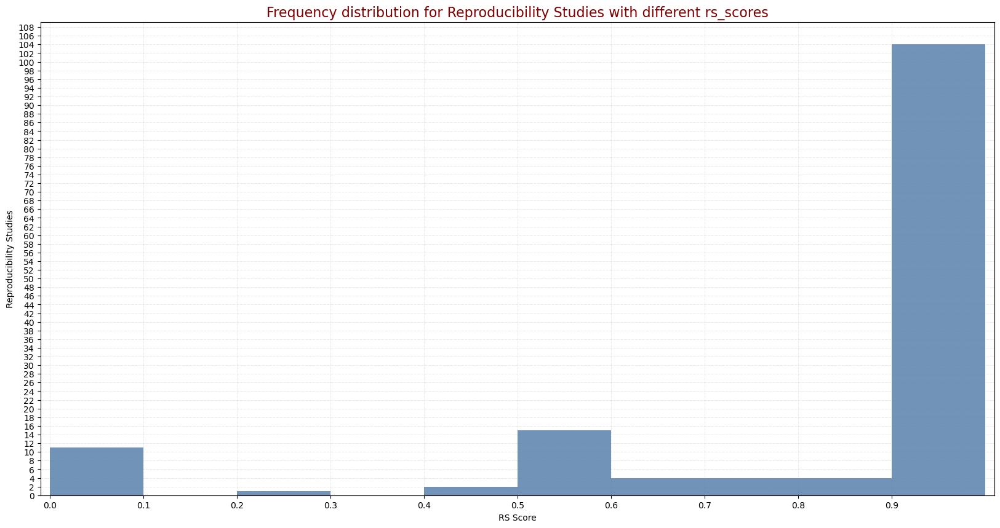

In [25]:
# keys_ = list(data.keys())
# counts = list(data.values())

# Figure 002 - Frequency distribution for number of countires with different survey counts
fig = plt.figure(figsize = (20, 10))
 
x = df_excel[df_excel['rs_score']!='NOT_RELEVANT']['rs_score'].astype(float)
print(list(x))
num_bins = 10

plt.xticks(np.arange(0, 1, step=0.1))
plt.yticks(np.arange(0, 120, step=2))

plt.xlabel("RS Score",fontsize=10)
plt.ylabel("Reproducibility Studies",fontsize=10)
plt.title("Frequency distribution for Reproducibility Studies with different rs_scores",fontsize=16, color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

plt.hist(x, num_bins, density=False,color=(0.2, 0.4, 0.6, 0.7),width = 1/num_bins)
plt.savefig("plots/R_001_Figure_002_10_bins.png",pad_inches=1)
plt.show()

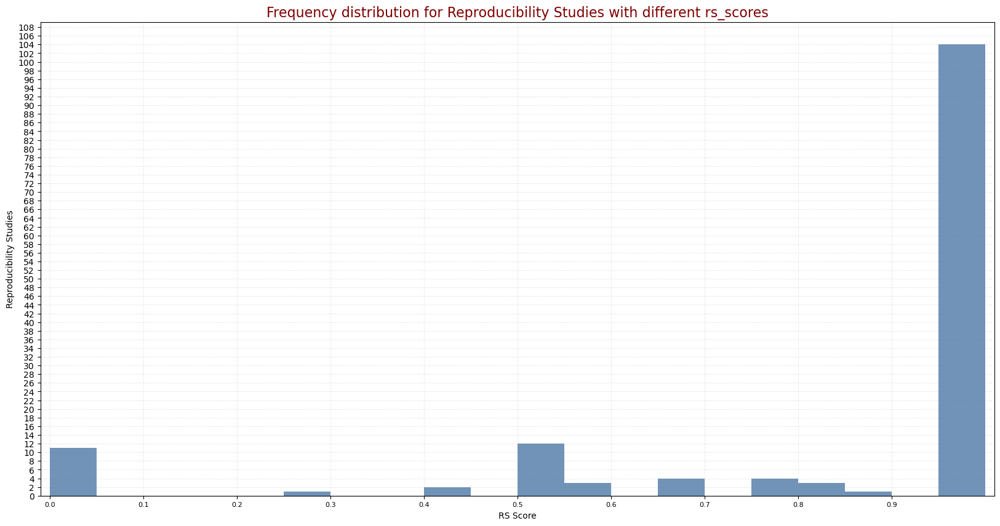

In [119]:
fig = plt.figure(figsize = (20, 10))
 
x = df_excel[df_excel['rs_score']!='NOT_RELEVANT']['rs_score'].astype(float)

num_bins = 20

plt.xticks(np.arange(0, 1, step=0.1))
plt.yticks(np.arange(0, 120, step=2))

plt.xlabel("RS Score",fontsize=10)
plt.ylabel("Reproducibility Studies",fontsize=10)
plt.title("Frequency distribution for Reproducibility Studies with different rs_scores",fontsize=16, color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

plt.hist(x, num_bins, density=False,color=(0.2, 0.4, 0.6, 0.7),width = 1/num_bins)
plt.savefig("plots/R_001_Figure_002_20_bins.png",pad_inches=1)
plt.show()

## ``visualizations on citing paper counts obtained from S2GA``

In [126]:
file_names_json = glob.glob("Citing_Paper_details/*.json")

file_names_json

['Citing_Paper_details\\RS_001_MLRC_2022_01.json',
 'Citing_Paper_details\\RS_002_MLRC_2022_02.json',
 'Citing_Paper_details\\RS_003_MLRC_2022_03.json',
 'Citing_Paper_details\\RS_004_MLRC_2022_04.json',
 'Citing_Paper_details\\RS_005_MLRC_2022_05.json',
 'Citing_Paper_details\\RS_006_MLRC_2022_06.json',
 'Citing_Paper_details\\RS_007_MLRC_2022_07.json',
 'Citing_Paper_details\\RS_008_MLRC_2022_08.json',
 'Citing_Paper_details\\RS_009_MLRC_2022_09.json',
 'Citing_Paper_details\\RS_010_MLRC_2022_10.json',
 'Citing_Paper_details\\RS_011_MLRC_2022_11.json',
 'Citing_Paper_details\\RS_012_MLRC_2022_12.json',
 'Citing_Paper_details\\RS_013_MLRC_2022_13.json',
 'Citing_Paper_details\\RS_014_MLRC_2022_14.json',
 'Citing_Paper_details\\RS_015_MLRC_2022_15.json',
 'Citing_Paper_details\\RS_016_MLRC_2022_16.json',
 'Citing_Paper_details\\RS_017_MLRC_2022_17.json',
 'Citing_Paper_details\\RS_018_MLRC_2022_18.json',
 'Citing_Paper_details\\RS_019_MLRC_2022_19.json',
 'Citing_Paper_details\\RS_020_

In [27]:
#old - manual counting
count_dict = {}

for file in file_names_json:
    with open(file) as f:
        cite_count = 0
        data = json.load(f)
        
        key_ =  file.split('\\')[1].replace('.json','')
        
#         take the count where year > 2022

        count_from_filter = len(list(filter(lambda x : int(x.get('year') or 0) > 2021, data['citations'])))

        for citation in data['citations']:
            if int(citation.get('year') or 0) > 2021:
                cite_count +=1
            
            print(citation['year'])

        print(key_,' --- ',len(data['citations']))
        print(key_,' --- ',cite_count)
        print(key_,' --- ',count_from_filter)
        
        count_dict[key_] = cite_count

    print('\n\n\n')
    
count_dict

with open('citation_counts_for_cited_papers.json', "w") as outfile:
    json_object = json.dumps(count_dict, indent=4)
    outfile.write(json_object)

2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2021
2021
2023
2023
2023
2023
2023
2022
2022
2022
None
RS_001_MLRC_2022_01  ---  71
RS_001_MLRC_2022_01  ---  68
RS_001_MLRC_2022_01  ---  68




2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2021
2021
2023
2023
2022
2022
2022
2022
RS_002_MLRC_2022_02  ---  63
RS_002_MLRC_2022_02  ---  61
RS_002_MLRC_2022_02  ---  61




2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2021
2023
2023
RS_003_MLRC_2022_03  ---  14
RS_003_MLRC_2022_03  ---  13
RS_003_MLRC_2022_03 

In [129]:
#new - from citationCount attribute
count_dict = {}

for file in file_names_json:
    with open(file) as f:
        cite_count = 0
        data = json.load(f)
        
        key_ =  file.split('\\')[1].replace('.json','')
        
#         take the count where year > 2022
        count_from_filter = len(list(filter(lambda x : int(x.get('year') or 0) > 2021, data['citations'])))

        for citation in data['citations']:
            if int(citation.get('year') or 0) > 2021:
                cite_count +=1
            
            print(citation['year'])

        print(key_,' --- ',len(data['citations']))
        print(key_,' --- ',cite_count)
        print(key_,' --- ',count_from_filter)
        
        count_dict[key_] = {'manual_count_after_2021':cite_count,'manual_count_all_retrieved':len(data['citations']),'citationCount':data['citationCount']}

    print('\n\n\n')
    
count_dict

with open('citation_counts_for_cited_papers.json', "w") as outfile:
    json_object = json.dumps(count_dict, indent=4)
    outfile.write(json_object)

2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2021
2021
2023
2023
2023
2023
2023
2023
2022
2022
2022
None
RS_001_MLRC_2022_01  ---  76
RS_001_MLRC_2022_01  ---  73
RS_001_MLRC_2022_01  ---  73




2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2022
2021
2021
2023
2023
2023
2022
2022
2022
2022
RS_002_MLRC_2022_02  ---  65
RS_002_MLRC_2022_02  ---  63
RS_002_MLRC_2022_02  ---  63




2023
2023
2023
2023
2023
2023
2022
2022
2022
2022
2022
2022
2021
2023
2023
RS_003_MLRC_2022_03  ---  15
RS_003_ML

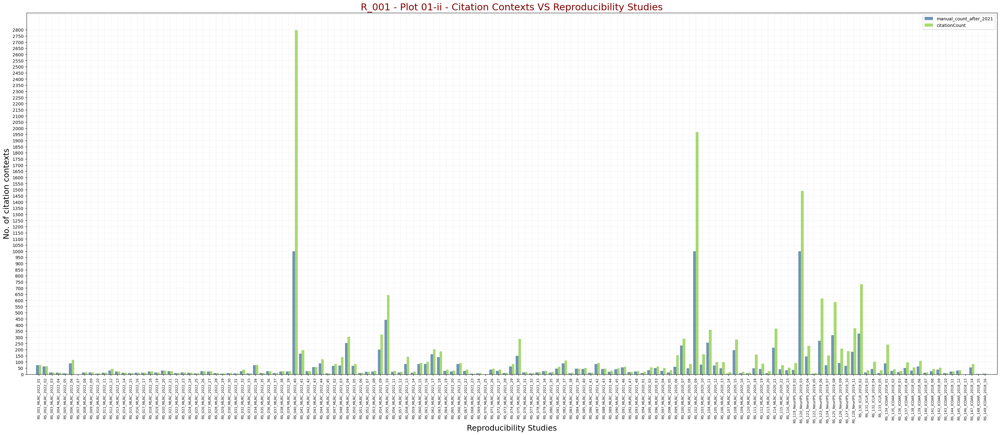

In [138]:
import matplotlib.pyplot as plt
import numpy as np

with open('citation_counts_for_cited_papers.json') as f:
    data = json.load(f)

keys_ = list(data.keys())
values = list(data.values())

manual_count_after_2021 = list(map(lambda x: x['manual_count_after_2021'],data.values())) 
manual_count_all_retrieved = list(map(lambda x: x['manual_count_all_retrieved'],data.values())) 
citationCount = list(map(lambda x: x['citationCount'],data.values())) 

labels = ("manual_count_after_2021", "manual_count_all_retrieved", "citationCount")
counts = {
    'manual_count_after_2021': manual_count_after_2021,
    'manual_count_all_retrieved': manual_count_all_retrieved,
    'citationCount': citationCount,
}

X = keys_


fig = plt.figure(figsize = (40, 15))
  
X_axis = np.arange(len(X)) 
  
plt.bar(X_axis - 0.2, manual_count_after_2021, color=(0.2, 0.4, 0.6, 0.7), label = 'manual_count_after_2021', width = 0.4) 
plt.bar(X_axis + 0.2, citationCount, label = 'citationCount', color=(0.5, 0.8, 0.2, 0.7), width = 0.4) 

 
# creating the bar plot
# plt.bar(keys_, counts, color=(0.2, 0.4, 0.6, 0.7),width = 0.8)

# plt.rc('xtick', labelsize=8)

# plt.xticks(rotation=90,fontsize=8)
plt.yticks(np.arange(0, 2850, step=50))

plt.xlabel("Reproducibility Studies",fontsize=18)
plt.ylabel("No. of citation contexts",fontsize=18)
plt.title("R_001 - Plot 01-ii - Citation Contexts VS Reproducibility Studies",fontsize=22,color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

# plt.show()



  
plt.xticks(X_axis, X,rotation=90,fontsize=8) 
# plt.xlabel("Groups") 
# plt.ylabel("Number of Students") 
# plt.title("Number of Students in each group") 
plt.legend() 
plt.show() 

In [131]:
with open('citation_counts_for_cited_papers.json') as f:
    data = json.load(f)

keys_ = list(data.keys())
values = list(data.values())


values


[{'manual_count_after_2021': 73,
  'manual_count_all_retrieved': 76,
  'citationCount': 76},
 {'manual_count_after_2021': 63,
  'manual_count_all_retrieved': 65,
  'citationCount': 65},
 {'manual_count_after_2021': 14,
  'manual_count_all_retrieved': 15,
  'citationCount': 15},
 {'manual_count_after_2021': 11,
  'manual_count_all_retrieved': 12,
  'citationCount': 12},
 {'manual_count_after_2021': 7,
  'manual_count_all_retrieved': 7,
  'citationCount': 7},
 {'manual_count_after_2021': 89,
  'manual_count_all_retrieved': 115,
  'citationCount': 115},
 {'manual_count_after_2021': 0,
  'manual_count_all_retrieved': 0,
  'citationCount': 0},
 {'manual_count_after_2021': 13,
  'manual_count_all_retrieved': 13,
  'citationCount': 13},
 {'manual_count_after_2021': 14,
  'manual_count_all_retrieved': 14,
  'citationCount': 14},
 {'manual_count_after_2021': 5,
  'manual_count_all_retrieved': 6,
  'citationCount': 6},
 {'manual_count_after_2021': 11,
  'manual_count_all_retrieved': 12,
  'citat

In [133]:
manual_count_after_2021 = []

manual_count_after_2021 = list(map(lambda x: x['manual_count_after_2021'],data.values())) 
manual_count_all_retrieved = list(map(lambda x: x['manual_count_all_retrieved'],data.values())) 
citationCount = list(map(lambda x: x['citationCount'],data.values())) 



citationCount

[76,
 65,
 15,
 12,
 7,
 115,
 0,
 13,
 14,
 6,
 12,
 42,
 23,
 11,
 9,
 12,
 11,
 23,
 15,
 30,
 24,
 10,
 15,
 12,
 7,
 24,
 25,
 9,
 6,
 9,
 7,
 36,
 6,
 76,
 10,
 24,
 9,
 25,
 25,
 2799,
 195,
 25,
 57,
 121,
 7,
 83,
 138,
 304,
 83,
 11,
 20,
 26,
 321,
 643,
 26,
 20,
 142,
 23,
 90,
 100,
 202,
 184,
 38,
 30,
 90,
 38,
 4,
 9,
 0,
 45,
 38,
 11,
 84,
 287,
 17,
 9,
 18,
 26,
 19,
 61,
 110,
 11,
 45,
 50,
 12,
 90,
 45,
 26,
 47,
 59,
 19,
 25,
 20,
 54,
 62,
 49,
 32,
 154,
 289,
 83,
 1969,
 162,
 361,
 98,
 98,
 18,
 281,
 20,
 11,
 160,
 85,
 24,
 370,
 73,
 52,
 90,
 1491,
 231,
 10,
 616,
 152,
 588,
 208,
 187,
 373,
 732,
 32,
 101,
 32,
 241,
 39,
 27,
 95,
 55,
 109,
 15,
 43,
 52,
 8,
 22,
 33,
 0,
 84,
 2,
 4]

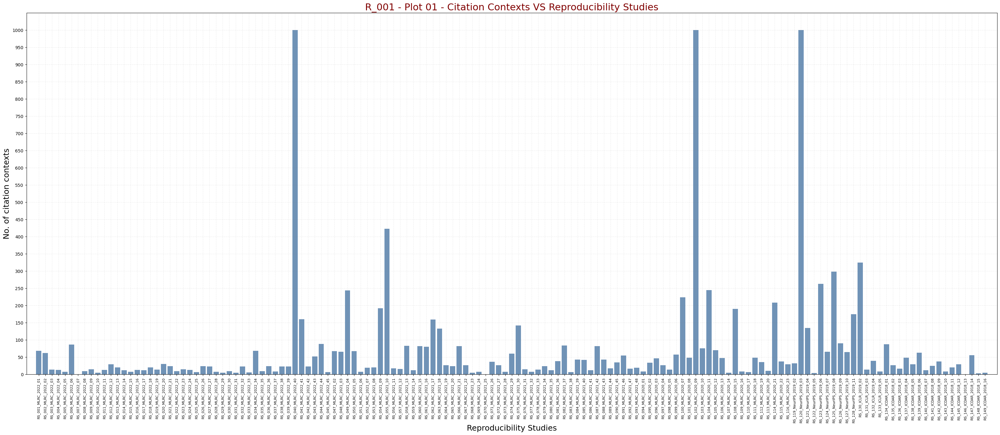

In [80]:
data = {}

with open('citation_counts_for_cited_papers.json') as f:
    data = json.load(f)

keys_ = list(data.keys())
counts = list(data.values())
  
fig = plt.figure(figsize = (40, 15))
 
# creating the bar plot
plt.bar(keys_, counts, color=(0.2, 0.4, 0.6, 0.7),width = 0.8)

# plt.rc('xtick', labelsize=8)

plt.xticks(rotation=90,fontsize=8)
plt.yticks(np.arange(0, 1001, step=50))

plt.xlabel("Reproducibility Studies",fontsize=18)
plt.ylabel("No. of citation contexts",fontsize=18)
plt.title("R_001 - Plot 01 - Citation Contexts VS Reproducibility Studies",fontsize=22,color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

plt.show()

In [8]:


courses = list(data.keys())
values = list(data.values())


data_formatted = {'key': courses,
        'count': values} 


In [9]:
df__ = pd.DataFrame.from_dict(data_formatted)
df__

,key,count
0,RS_001_MLRC_2022_01,68
1,RS_002_MLRC_2022_02,61
2,RS_003_MLRC_2022_03,13
3,RS_004_MLRC_2022_04,12
4,RS_005_MLRC_2022_05,7
...,...,...
140,RS_145_ICDAR_2018_12,29
141,RS_146_ICDAR_2018_13,0
142,RS_147_ICDAR_2018_14,55
143,RS_148_ICDAR_2018_15,2


<Axes: xlabel='key', ylabel='count'>

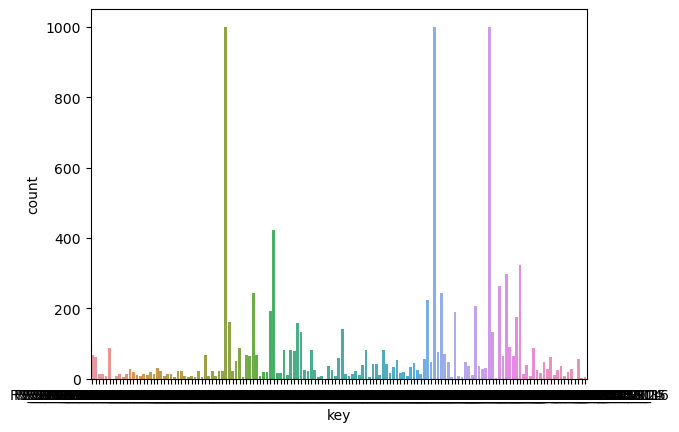

In [11]:
import seaborn as sns

sns.barplot(data=df__, x="key", y="count")

In [54]:
with open('citation_counts_for_cited_papers.json') as f:
    data = json.load(f)

# keys_ = list(data.keys())
# counts = list(data.values())
data

# df_excel_ = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
# df_excel_


# for i, row in df_excel_.iterrows():
    
#     if row['key_for_all_RS'] in data.keys():
#         df_excel_.at[i, 'citation_count_org'] = int(data[row['key_for_all_RS']]['citationCount'])
#     else:
#         df_excel_.at[i, 'citation_count_org'] = 0
    
# #     index_ = i+1
# #     key_from_prev = row['introduced_title_pdf_rs'].partition('_')[0]
# #     key = "RS_{:0>3}_MLRC_{}_{:0>2}".format(i+1,str(result['mlrc_challenge_year'][i]),key_from_prev)

# #     index_start +=1
# #     result.at[i, 'Key_for_all_RS'] = key

# # df_excel_[['citation_count_org']].astype(int)

# df_excel_[["key_for_all_RS",'citation_count_org']]

# df_excel_.to_excel("RS_ALL_IN_ONE_with_citation_count.xlsx",index=False)

{'RS_001_MLRC_2022_01': {'manual_count_after_2021': 73,
  'manual_count_all_retrieved': 76,
  'citationCount': 76},
 'RS_002_MLRC_2022_02': {'manual_count_after_2021': 63,
  'manual_count_all_retrieved': 65,
  'citationCount': 65},
 'RS_003_MLRC_2022_03': {'manual_count_after_2021': 14,
  'manual_count_all_retrieved': 15,
  'citationCount': 15},
 'RS_004_MLRC_2022_04': {'manual_count_after_2021': 11,
  'manual_count_all_retrieved': 12,
  'citationCount': 12},
 'RS_005_MLRC_2022_05': {'manual_count_after_2021': 7,
  'manual_count_all_retrieved': 7,
  'citationCount': 7},
 'RS_006_MLRC_2022_06': {'manual_count_after_2021': 89,
  'manual_count_all_retrieved': 115,
  'citationCount': 115},
 'RS_007_MLRC_2022_07': {'manual_count_after_2021': 0,
  'manual_count_all_retrieved': 0,
  'citationCount': 0},
 'RS_008_MLRC_2022_08': {'manual_count_after_2021': 13,
  'manual_count_all_retrieved': 13,
  'citationCount': 13},
 'RS_009_MLRC_2022_09': {'manual_count_after_2021': 14,
  'manual_count_all_

In [ ]:
df_excel_ = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
df_excel_


for i, row in df_excel_.iterrows():
    
    if row['key_for_all_RS'] in data.keys():
        df_excel_.at[i, 'citation_count_org'] = int(data[row['key_for_all_RS']]['citationCount'])

In [6]:
df_doi = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")

# df_doi['s2ga_key']

FOLDER_NAME = 'Citing_Paper_contexts/'

if not os.path.exists(FOLDER_NAME):
    os.makedirs(FOLDER_NAME)


for index, row in df_doi.iterrows():
    
    if 'NOT_RE' in row['s2ga_key']:
        continue
    
    url = "https://api.semanticscholar.org/graph/v1/paper/{s2ga_key}/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000".format(s2ga_key=row['s2ga_key'])
    
    #     handling 1000 retrieval limitation per request
    page = requests.get(url)
    all_data = page.json()

#     print(all_data)

#     row ={'citation_count_org':2900}
    limit = 1000

    #     handling 1000 retrieval limitation per request
    if row['citation_count_org']>1000:
        for index in range(0,int(row['citation_count_org']/1000)):
            time.sleep(3)
            step = index+1
            print(index,'--', step)
    #         1001 - 2000
            print('offset',(step*limit+1),'until:',(step+1)*1000)

            offset_ = step*limit # step*limit+1
    #         limit_ = (step+1)*1000

            url = "https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset={offset}&limit={limit}".format(offset=offset_,limit=limit)

            print(url)

            page = requests.get(url)
            new_page_ = page.json()

            print(new_page_)

            all_data['data'].extend(new_page_['data']) 

            print("len(all_data['data']):",len(all_data['data']))

    
#     page = requests.get(url)
    
#     json_object = json.dumps(page.json(), indent=4)
    json_object = json.dumps(all_data, indent=4)

    print(row['key_for_all_RS'])
    print("citation_count_org :",row['citation_count_org'])
    print("len(all_data['data']) :",len(all_data['data']))
    print(url)

    
#     print('len(json_object["data"]) : ',len(json_object['data']))
    
    print('page.status_code: ',page.status_code)
    
    file_name = row['key_for_all_RS']+'.json'
    out_file_name = os.path.join(FOLDER_NAME, file_name)
    
#     if index == 3:
#         break
    
    
    with open(out_file_name, "w") as outfile:
        outfile.write(json_object)
    
    time.sleep(3)
    
    print('\n\n\n')

RS_001_MLRC_2022_01
citation_count_org : 76
len(all_data['data']) : 76
https://api.semanticscholar.org/graph/v1/paper/arXiv:2202.07179/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_002_MLRC_2022_02
citation_count_org : 65
len(all_data['data']) : 65
https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.00787/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_003_MLRC_2022_03
citation_count_org : 15
len(all_data['data']) : 15
https://api.semanticscholar.org/graph/v1/paper/arXiv:2202.05826/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_004_MLRC_2022_04
citation_count_org : 12
len(all_data['data']) : 12
https://api.seman





RS_028_MLRC_2022_28
citation_count_org : 9
len(all_data['data']) : 9
https://api.semanticscholar.org/graph/v1/paper/arXiv:2106.03761/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_029_MLRC_2022_29
citation_count_org : 6
len(all_data['data']) : 6
https://api.semanticscholar.org/graph/v1/paper/10.1007/978-3-031-19775-8_26/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_030_MLRC_2022_30
citation_count_org : 9
len(all_data['data']) : 9
https://api.semanticscholar.org/graph/v1/paper/arXiv:2111.13650/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_031_MLRC_2022_31
citation_count_org : 7
len(all_data['data']) : 7
https://api.semantics

1 -- 2
offset 2001 until: 3000
https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=2000&limit=1000
{'offset': 2000, 'data': [{'contexts': [], 'intents': [], 'isInfluential': False, 'citingPaper': {'paperId': '13ea26e72f8c574100ef44593a26ff1a2778d4bf', 'externalIds': {'ArXiv': '2208.04268', 'DBLP': 'journals/corr/abs-2208-04268', 'DOI': '10.48550/arXiv.2208.04268', 'CorpusId': 251403268}, 'corpusId': 251403268, 'publicationVenue': {'id': '1901e811-ee72-4b20-8f7e-de08cd395a10', 'name': 'arXiv.org', 'alternate_names': ['ArXiv'], 'issn': '2331-8422', 'url': 'https://arxiv.org'}, 'url': 'https://www.semanticscholar.org/paper/13ea26e72f8c574100ef44593a26ff1a2778d4bf', 'title': 'Label-Free Synthetic Pretraining of Object Detectors', 'abstract': 'We propose a new approach, Synthetic Optimized Layout with Instance Detection (SOLID), to pretrain obj

RS_040_MLRC_2022_40
citation_count_org : 2799
len(all_data['data']) : 2799
https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=2000&limit=1000
page.status_code:  200




RS_041_MLRC_2022_41
citation_count_org : 195
len(all_data['data']) : 195
https://api.semanticscholar.org/graph/v1/paper/arXiv:2102.05152/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_042_MLRC_2022_42
citation_count_org : 25
len(all_data['data']) : 25
https://api.semanticscholar.org/graph/v1/paper/arXiv:2205.10343/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_043_MLRC_2022_43
citation_count_org : 57
len(all_data['data']) : 57
https://





RS_068_MLRC_2021_23
citation_count_org : 4
len(all_data['data']) : 4
https://api.semanticscholar.org/graph/v1/paper/10.24963/ijcai.2021/305/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_069_MLRC_2021_24
citation_count_org : 9
len(all_data['data']) : 9
https://api.semanticscholar.org/graph/v1/paper/CorpusId:235826474/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_070_MLRC_2021_25
citation_count_org : 0
len(all_data['data']) : 0
https://api.semanticscholar.org/graph/v1/paper/CorpusId:260422035/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_071_MLRC_2021_26
citation_count_org : 45
len(all_data['data']) : 45
https://api.semantic





RS_095_MLRC_2020_02
citation_count_org : 54
len(all_data['data']) : 54
https://api.semanticscholar.org/graph/v1/paper/arXiv:1909.06043/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_096_MLRC_2020_03
citation_count_org : 62
len(all_data['data']) : 62
https://api.semanticscholar.org/graph/v1/paper/arXiv:2006.08195/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_097_MLRC_2020_04
citation_count_org : 49
len(all_data['data']) : 49
https://api.semanticscholar.org/graph/v1/paper/10.1109/cvpr42600.2020.00909/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_098_MLRC_2020_05
citation_count_org : 32
len(all_data['data']) : 32
https://api.s

RS_102_MLRC_2020_09
citation_count_org : 1969
len(all_data['data']) : 2000
https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=1000&limit=1000
page.status_code:  200




RS_103_MLRC_2020_10
citation_count_org : 162
len(all_data['data']) : 162
https://api.semanticscholar.org/graph/v1/paper/arXiv:1905.00076/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_104_MLRC_2020_11
citation_count_org : 361
len(all_data['data']) : 361
https://api.semanticscholar.org/graph/v1/paper/10.1109/cvpr42600.2020.01438/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_105_MLRC_2020_12
citation_count_org : 98
len(all_data['data'])





RS_121_NeurIPS_2019_04
citation_count_org : 231
len(all_data['data']) : 231
https://api.semanticscholar.org/graph/v1/paper/arXiv:1901.10738/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_122_NeurIPS_2019_05
citation_count_org : 10
len(all_data['data']) : 10
https://api.semanticscholar.org/graph/v1/paper/arXiv:1806.08593/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_123_NeurIPS_2019_06
citation_count_org : 616
len(all_data['data']) : 616
https://api.semanticscholar.org/graph/v1/paper/arXiv:1906.01563/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200




RS_124_NeurIPS_2019_07
citation_count_org : 152
len(all_data['data']) : 152
https:/





RS_149_ICDAR_2018_16
citation_count_org : 4
len(all_data['data']) : 4
https://api.semanticscholar.org/graph/v1/paper/10.1007/978-3-030-86331-9_35/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000
page.status_code:  200






In [5]:
# url = "https://api.semanticscholar.org/graph/v1/paper/{s2ga_key}/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000".format(s2ga_key=row['s2ga_key'])

url = "https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset=0&limit=1000"

page = requests.get(url)
all_data = page.json()

print(all_data)

row ={'citation_count_org':2900}
limit = 1000

#     handling 1000 retrieval limitation per request
if row['citation_count_org']>1000:
    for index in range(0,int(row['citation_count_org']/1000)):
        step = index+1
        print(index,'--', step)
#         1001 - 2000
        print('offset',(step*limit+1),'until:',(step+1)*1000)
        
        offset_ = step*limit
#         limit_ = (step+1)*1000
        
        url = "https://api.semanticscholar.org/graph/v1/paper/10.1109/CVPR52688.2022.01553/citations?fields=contexts,intents,isInfluential,abstract,title,year,publicationVenue,corpusId,externalIds,url,authors&offset={offset}&limit={limit}".format(offset=offset_,limit=limit)

        print(url)
        
        page = requests.get(url)
        new_page_ = page.json()
        
        print(new_page_)
        
        all_data['data'].extend(new_page_['data']) 
        
        print("len(all_data['data']):",len(all_data['data']))
        

        
json_object = json.dumps(all_data, indent=4)

with open('out_file_name.json', "w") as outfile:
    outfile.write(json_object)






{'offset': 0, 'next': 1000, 'data': [{'intents': [], 'isInfluential': False, 'contexts': [], 'citingPaper': {'paperId': 'ed75271269f18d8c34c3008ad5a909eed784e03e', 'externalIds': {'DBLP': 'journals/pr/JiZSFL23', 'DOI': '10.1016/j.patcog.2023.109766', 'CorpusId': 259555783}, 'corpusId': 259555783, 'publicationVenue': {'id': '266f640f-003e-453b-ab76-57e4053252f8', 'name': 'Pattern Recognition', 'type': 'journal', 'alternate_names': ['Pattern Recognit'], 'issn': '0031-3203', 'url': 'http://www.elsevier.com/wps/find/journaldescription.cws_home/328/description#description', 'alternate_urls': ['https://www.journals.elsevier.com/pattern-recognition', 'http://www.sciencedirect.com/science/journal/00313203']}, 'url': 'https://www.semanticscholar.org/paper/ed75271269f18d8c34c3008ad5a909eed784e03e', 'title': 'Higher-order memory guided temporal random walk for dynamic heterogeneous network embedding', 'abstract': None, 'year': 2023, 'authors': [{'authorId': '2052296239', 'name': 'Cheng Ji'}, {'au

{'offset': 1000, 'next': 2000, 'data': [{'intents': ['methodology'], 'isInfluential': False, 'contexts': ['The MAE learns these unknown regions to reconstruct the masked patches, and achieves excellent results.', '1) Batch Random Mask Block: In order to obtain more robust features and make the prediction of the network adapt to complex and changeable environments, we propose a batch random mask (BRM) block inspired by the Masked AutoEncoders (MAE) [50], in which the random patches of the image are masked to reconstruct these missing regions by the model.'], 'citingPaper': {'paperId': '8f6aa4e58cbd68e60873225b377c0af2f2104d35', 'externalIds': {'DBLP': 'journals/corr/abs-2304-07230', 'ArXiv': '2304.07230', 'DOI': '10.48550/arXiv.2304.07230', 'CorpusId': 258170473}, 'corpusId': 258170473, 'publicationVenue': None, 'url': 'https://www.semanticscholar.org/paper/8f6aa4e58cbd68e60873225b377c0af2f2104d35', 'title': 'PARFormer: Transformer-based Multi-Task Network for Pedestrian Attribute Recog

{'offset': 2000, 'data': [{'contexts': [], 'intents': [], 'isInfluential': False, 'citingPaper': {'paperId': '13ea26e72f8c574100ef44593a26ff1a2778d4bf', 'externalIds': {'ArXiv': '2208.04268', 'DBLP': 'journals/corr/abs-2208-04268', 'DOI': '10.48550/arXiv.2208.04268', 'CorpusId': 251403268}, 'corpusId': 251403268, 'publicationVenue': {'id': '1901e811-ee72-4b20-8f7e-de08cd395a10', 'name': 'arXiv.org', 'alternate_names': ['ArXiv'], 'issn': '2331-8422', 'url': 'https://arxiv.org'}, 'url': 'https://www.semanticscholar.org/paper/13ea26e72f8c574100ef44593a26ff1a2778d4bf', 'title': 'Label-Free Synthetic Pretraining of Object Detectors', 'abstract': 'We propose a new approach, Synthetic Optimized Layout with Instance Detection (SOLID), to pretrain object detectors with synthetic images. Our"SOLID"approach consists of two main components: (1) generating synthetic images using a collection of unlabelled 3D models with optimized scene arrangement; (2) pretraining an object detector on"instance det

In [184]:
with open('out_file_name.json', "r") as outfile:
#     json_ = outfile.read()
    
    test = json.load(outfile)
    
    print(test['data'])

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
# Opening JSON file
f = open('out_file_name.json', "r")
 
# returns JSON object as 
# a dictionary
data = json.load(f)
len(data['data'])

2799

In [21]:


# data
pd.set_option('display.max_columns', None)

In [255]:
#Frequency distribution for citing papers

df_excel = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
print(len(df_excel['rs_score']))

len(df_excel[df_excel['rs_score']!='NOT_RELEVANT']['rs_score'].astype(float))

new_df = df_excel[df_excel['rs_score']!='NOT_RELEVANT']
new_df

149


,key_for_all_RS,title_rs,authors_rs,article_type,keywords,abstract,pdf_url_rs,code_url_rs,org_paper_url,doi_rs,...,volume_journal_rs,issue_journal_rs,published_year_journal_rs,domain,entry_type,rs_score,total_claims_or_attempts,results_threshold,rs_score_comment,rs_comment
0,RS_001_MLRC_2022_01,[Re] $\mathcal{G}$-Mixup: Graph Data Augmentat...,"['Ermin Omeragic', 'Vuk ÄuranoviÄ‡']",Replication,"['rescience c', 'machine learning', 'data augm...",Scope of Reproducibility\nThis paper presents ...,/pdf/8c87cb1e84e1482826c40a3b0c43928eaef747f3.pdf,NaN,https://proceedings.mlr.press/v162/han22c.html,https://www.doi.org/10.5281/zenodo.8173650,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.43,8,Not given,3.5/8,Results — Due to many missing implementation d...
1,RS_002_MLRC_2022_02,[Re] Exact Feature Distribution Matching for A...,"['Mert Erkol', 'Furkan KÄ±nlÄ±', 'BarÄ±ÅŸ Ã–zc...",Replication,"['feature distribution matching', 'style trans...",Reproducibility Summary:\n\nIn this reproducib...,/pdf/7bcb577c2a46db29c48234a5b72368053c7ebed3.pdf,NaN,https://openaccess.thecvf.com/content/CVPR2022...,https://www.doi.org/10.5281/zenodo.8173652,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,5,Not given,Although our experimental results are not\nide...,Results — We have reproduced the experiments d...
2,RS_003_MLRC_2022_03,[Re] End-to-end Algorithm Synthesis with Recur...,"['Sean Michael McLeish', 'Long Tran-Thanh']",Replication,"['rescience c', 'Algorithmic Reasoning', 'Deep...","Scope of Reproducibility:\nIn this report, we ...",/pdf/07d5d68b5873d779bd1fd8c95b9767cb57fe0bc4.pdf,NaN,https://arxiv.org/pdf/2202.05826.pdf,https://www.doi.org/10.5281/zenodo.8173654,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,3,Not given,apart from perturbation testing for which we p...,Results — We verify the authors’ claims by rep...
3,RS_004_MLRC_2022_04,[Re] Label-Free Explainability for Unsupervise...,"['Eric Langezaal', 'Jesse Belleman', 'Joeri No...",Replication,"['Reproducibility', 'label-free', 'unsupervise...",Scope of Reproducibility â€” This study is an ...,/pdf/7fde4f12c675150699fc376cd097d5b9dad0b4d4.pdf,NaN,https://proceedings.mlr.press/v162/crabbe22a.html,https://www.doi.org/10.5281/zenodo.8173656,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,1,3,Not given,"Our results differ in some minor aspects, but ...",Results — We find that the three main claims o...
4,RS_005_MLRC_2022_05,[Re] Exploring the Representation of Word Mean...,"['Matteo Brivio', 'Cagri Coltekin']",Replication,"['BERT', 'fastText', 'embeddings', 'language m...",This report summarizes our efforts to reproduc...,/pdf/78430c5af33bc892d852b49a5a6e93abeb314c6f.pdf,NaN,https://aclanthology.org/2021.acl-long.281/,https://www.doi.org/10.5281/zenodo.8173658,...,NaN,NaN,NaN,ML Reproducibility Challenge 2021,article,0.75,4,Not given,We only manage to partially reproduce the orig...,Results — We only manage to partially reproduc...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,RS_145_ICDAR_2018_12,LGPMA: Complicated Table Structure Recognition...,"[Liang Qiao, Zaisheng Li, Zhanzhan Cheng, Peng...",original,[test],NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,article,0,1,not reproducible based on Kenny's study,NaN,Non-Reproducible - Kenny's Remarks
145,RS_146_ICDAR_2018_13,Deep-learning and graph-based approach to tabl...,"[Lee, E., Park, J., Koo, H.I. et al.]",original,[test],NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,article,1,1,The source code was executed without errors an...,NaN,Reproducible - Kenny's Remarks
146,RS_147_ICDAR_2018_14,Global Table Extractor (GTE): A Framework for ...,"Zheng, Xinyi and Burdick, Douglas and Popa, Lu...",original,[test],NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,article,0,1,not reproducible based on Kenny's study,NaN,Non-Reproducible - Kenny's Remarks
147,RS_148_ICDAR_2018_15,TSR-DSAW: Table Structure Recognition via Deep...,[Arushi Jain and Shubham Paliwal and Monika Sh...,

[76, 65, 15, 12, 7, 115, 0, 13, 14, 6, 12, 42, 23, 11, 9, 12, 11, 23, 15, 30, 24, 10, 15, 12, 7, 24, 25, 9, 6, 9, 7, 36, 6, 76, 10, 24, 9, 25, 25, 2799, 195, 25, 57, 121, 7, 83, 138, 304, 83, 11, 20, 26, 321, 643, 26, 20, 142, 23, 90, 100, 202, 184, 38, 30, 90, 38, 4, 9, 0, 45, 38, 11, 84, 287, 17, 9, 18, 26, 19, 61, 110, 11, 45, 50, 12, 90, 45, 26, 47, 59, 19, 25, 20, 54, 62, 49, 32, 154, 289, 83, 1969, 162, 361, 98, 98, 18, 281, 20, 11, 160, 85, 24, 370, 73, 52, 90, 1491, 231, 10, 616, 152, 588, 208, 187, 373, 732, 32, 101, 32, 241, 39, 27, 95, 55, 109, 15, 43, 52, 8, 22, 33, 0, 84, 2, 4]


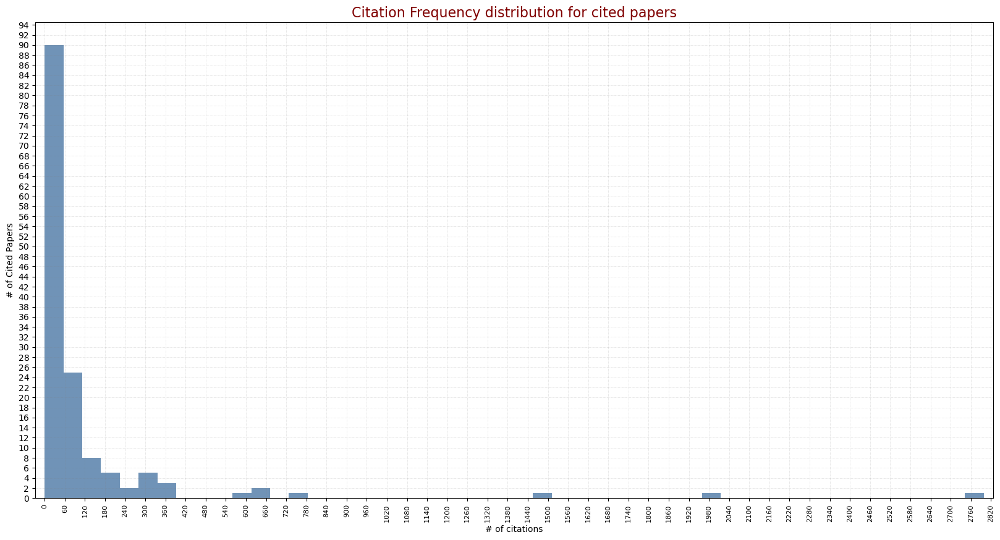

In [256]:
# Figure 002 - Frequency distribution for number of countires with different survey counts
fig = plt.figure(figsize = (20, 10))
 
x = list(new_df['citation_count_org']) #.astype(int)

print(x)

num_bins = 50

plt.xticks(np.arange(0, 3000, step=60))
plt.yticks(np.arange(0, 100, step=2))

plt.xticks(rotation=90)

plt.xlabel("# of citations",fontsize=10)
plt.ylabel("# of Cited Papers",fontsize=10)
plt.title("Citation Frequency distribution for cited papers",fontsize=16, color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

# plt.hist(x, num_bins, density=False,color=(0.2, 0.4, 0.6, 0.7),width = 1/num_bins)
plt.hist(x, num_bins,color=(0.2, 0.4, 0.6, 0.7),density=False)
plt.savefig("plots/R_001_Figure_003_Citation_Frequency_distribution_for_cited_papers.png",pad_inches=1)
plt.show()

Axes(0.125,0.11;0.775x0.77)
[76, 65, 15, 12, 7, 115, 0, 13, 14, 6, 12, 42, 23, 11, 9, 12, 11, 23, 15, 30, 24, 10, 15, 12, 7, 24, 25, 9, 6, 9, 7, 36, 6, 76, 10, 24, 9, 25, 25, 2799, 195, 25, 57, 121, 7, 83, 138, 304, 83, 11, 20, 26, 321, 643, 26, 20, 142, 23, 90, 100, 202, 184, 38, 30, 90, 38, 4, 9, 0, 45, 38, 11, 84, 287, 17, 9, 18, 26, 19, 61, 110, 11, 45, 50, 12, 90, 45, 26, 47, 59, 19, 25, 20, 54, 62, 49, 32, 154, 289, 83, 1969, 162, 361, 98, 98, 18, 281, 20, 11, 160, 85, 24, 370, 73, 52, 90, 1491, 231, 10, 616, 152, 588, 208, 187, 373, 732, 32, 101, 32, 241, 39, 27, 95, 55, 109, 15, 43, 52, 8, 22, 33, 0, 84, 2, 4]


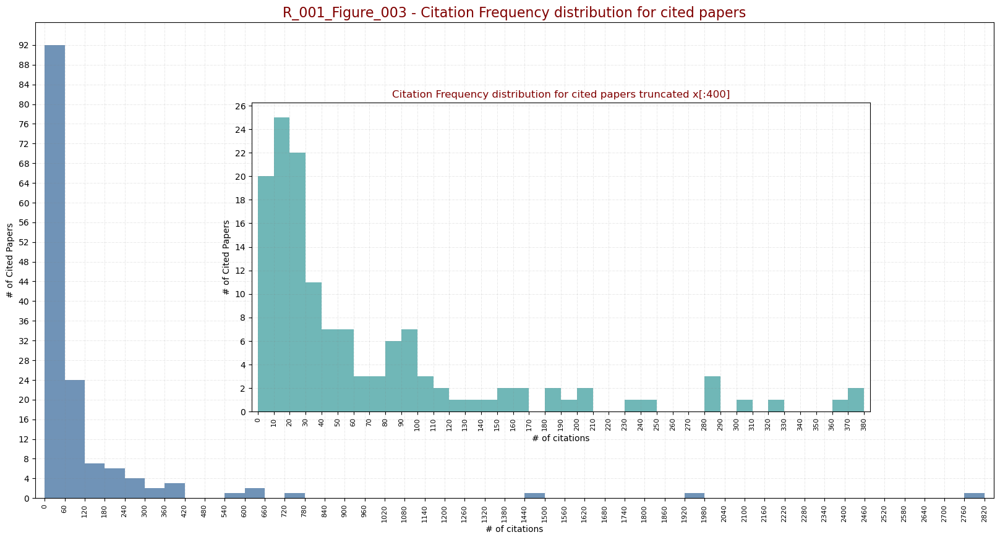

In [271]:
# Adding the inset

import matplotlib.pyplot as plt

fig, ax1 = plt.subplots(figsize = (20, 10))

# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [0.3, 0.25, 0.5, 0.5]
ax2 = fig.add_axes([left, bottom, width, height])

print(ax1)
 
x = list(new_df['citation_count_org']) #.astype(int)

print(x)


# binwidth = 60
# ax1.set(xticks=np.arange(0, 3001, step=binwidth)) #, xticklabels=labels)
# ax1.set(yticks=np.arange(0, 120, step=4))

# ax1.hist(x, bins=np.arange(min(x), max(x) + binwidth, binwidth),color=(0.2, 0.4, 0.6, 0.7),density=False)




binwidth = 60
ax1.set(xticks=np.arange(0, 3000, step=binwidth)) #, xticklabels=labels)
ax1.set(yticks=np.arange(0, 95, step=4))
ax1.tick_params(axis='x', labelrotation=90)

ax1.set_xlabel("# of citations",fontsize=10)
ax1.set_ylabel("# of Cited Papers",fontsize=10)
ax1.set_title("R_001_Figure_003 - Citation Frequency distribution for cited papers",fontsize=16, color='maroon')

ax1.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
ax1.margins(x=0.01, tight=True)

# ax1.hist(x, num_bins_1,color=(0.2, 0.4, 0.6, 0.7),density=False)
ax1.hist(x, bins=np.arange(min(x), max(x) + binwidth, binwidth),color=(0.2, 0.4, 0.6, 0.7),density=False)
# ax1.figure.savefig("plots/R_001_Figure_003_Citation_Frequency_distribution_for_cited_papers.png",pad_inches=1)



binwidth_2 = 10
x2 = [i for i in x if i<400]
ax2.set(xticks=np.arange(0, 400, step=binwidth_2)) #, xticklabels=labels)
ax2.set(yticks=np.arange(0, 100, step=2))

ax2.tick_params(axis='x', labelrotation=90)
ax2.set_xlabel("# of citations",fontsize=10)
ax2.set_ylabel("# of Cited Papers",fontsize=10)
ax2.set_title("Citation Frequency distribution for cited papers truncated x[:400]",fontsize=12, color='maroon')

ax2.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
ax2.margins(x=0.01, tight=True)

# ax2.hist(x2, num_bins_2,color=(0.2, 0.6, 0.6, 0.7),density=False)
ax2.hist(x2, bins=np.arange(min(x2), max(x2) + binwidth_2, binwidth_2),color=(0.2, 0.6, 0.6, 0.7),density=False)
# ax1.figure.savefig("plots/R_001_Figure_003_Citation_Frequency_distribution_for_cited_papers.png",pad_inches=1)
# ax2.plot(range(6)[::-1], color='green')

plt.savefig("plots/R_001_Figure_003_Citation_Frequency_distribution_for_cited_papers.png",pad_inches=1)


plt.show()

In [27]:
# not zero citations

file_names_json = glob.glob("Citing_Paper_contexts/*.json")

file_names_json

['Citing_Paper_contexts\\RS_001_MLRC_2022_01.json',
 'Citing_Paper_contexts\\RS_002_MLRC_2022_02.json',
 'Citing_Paper_contexts\\RS_003_MLRC_2022_03.json',
 'Citing_Paper_contexts\\RS_004_MLRC_2022_04.json',
 'Citing_Paper_contexts\\RS_005_MLRC_2022_05.json',
 'Citing_Paper_contexts\\RS_006_MLRC_2022_06.json',
 'Citing_Paper_contexts\\RS_007_MLRC_2022_07.json',
 'Citing_Paper_contexts\\RS_008_MLRC_2022_08.json',
 'Citing_Paper_contexts\\RS_009_MLRC_2022_09.json',
 'Citing_Paper_contexts\\RS_010_MLRC_2022_10.json',
 'Citing_Paper_contexts\\RS_011_MLRC_2022_11.json',
 'Citing_Paper_contexts\\RS_012_MLRC_2022_12.json',
 'Citing_Paper_contexts\\RS_013_MLRC_2022_13.json',
 'Citing_Paper_contexts\\RS_014_MLRC_2022_14.json',
 'Citing_Paper_contexts\\RS_015_MLRC_2022_15.json',
 'Citing_Paper_contexts\\RS_016_MLRC_2022_16.json',
 'Citing_Paper_contexts\\RS_017_MLRC_2022_17.json',
 'Citing_Paper_contexts\\RS_018_MLRC_2022_18.json',
 'Citing_Paper_contexts\\RS_019_MLRC_2022_19.json',
 'Citing_Pap

In [29]:
#new - from citationCount attribute
count_dict = {}

for file in file_names_json:
    with open(file) as f:
        cite_count = 0
        data = json.load(f)
        
        key_ =  file.split('\\')[1].replace('.json','')
        
#         take the count where year > 2022
        count_from_filter = len(list(filter(lambda x : x.get('contexts') != [], data['data'])))

        print(count_from_filter)
#         print(len(data['data']))

        item_ = {}
        for number, citation in enumerate(data['data']):
            if (citation.get('contexts') != []):
#                 print(citation.get('contexts'))
                item_[number] = len(citation.get('contexts'))
                print(number,'----',count_from_filter,'-----',len(citation.get('contexts')))

#             ## if int( or 0):
#             cite_count +=1
            
#             print(citation['year'])

        print(key_,' --- ',len(data['data']))
#         print(key_,' --- ',cite_count)
#         print(key_,' --- ',count_from_filter)

        total_context_count_for_labelling = sum(item_.values())
        
        count_dict[key_] = {'context_non_zero_citing_paper_count':count_from_filter ,
                            'citationCount':len(data['data']),
                            'total_context_count_for_labelling':total_context_count_for_labelling,
                            'contexts_per_citing_paper':item_}

#     if cite_count ==2:
#         break
    print('\n\n\n')
    
count_dict

with open('citation_context_counts_for_cited_papers.json', "w") as outfile:
    json_object = json.dumps(count_dict, indent=4)
    outfile.write(json_object)

57
2 ---- 57 ----- 3
3 ---- 57 ----- 5
5 ---- 57 ----- 7
6 ---- 57 ----- 1
7 ---- 57 ----- 4
8 ---- 57 ----- 1
9 ---- 57 ----- 1
10 ---- 57 ----- 7
13 ---- 57 ----- 1
14 ---- 57 ----- 3
15 ---- 57 ----- 1
16 ---- 57 ----- 2
18 ---- 57 ----- 1
19 ---- 57 ----- 1
20 ---- 57 ----- 1
22 ---- 57 ----- 9
23 ---- 57 ----- 4
24 ---- 57 ----- 1
25 ---- 57 ----- 3
26 ---- 57 ----- 1
27 ---- 57 ----- 1
31 ---- 57 ----- 1
32 ---- 57 ----- 1
33 ---- 57 ----- 1
34 ---- 57 ----- 1
35 ---- 57 ----- 1
36 ---- 57 ----- 2
37 ---- 57 ----- 2
38 ---- 57 ----- 7
39 ---- 57 ----- 3
40 ---- 57 ----- 2
41 ---- 57 ----- 1
42 ---- 57 ----- 1
43 ---- 57 ----- 3
44 ---- 57 ----- 2
45 ---- 57 ----- 1
46 ---- 57 ----- 2
47 ---- 57 ----- 2
48 ---- 57 ----- 1
50 ---- 57 ----- 5
51 ---- 57 ----- 8
52 ---- 57 ----- 1
53 ---- 57 ----- 1
55 ---- 57 ----- 1
56 ---- 57 ----- 10
57 ---- 57 ----- 1
58 ---- 57 ----- 1
59 ---- 57 ----- 5
62 ---- 57 ----- 2
63 ---- 57 ----- 1
64 ---- 57 ----- 4
65 ---- 57 ----- 1
66 ---- 57 ----

141
0 ---- 141 ----- 9
1 ---- 141 ----- 5
2 ---- 141 ----- 2
3 ---- 141 ----- 3
4 ---- 141 ----- 1
9 ---- 141 ----- 1
11 ---- 141 ----- 1
12 ---- 141 ----- 1
13 ---- 141 ----- 1
14 ---- 141 ----- 2
16 ---- 141 ----- 3
17 ---- 141 ----- 2
20 ---- 141 ----- 1
21 ---- 141 ----- 4
25 ---- 141 ----- 8
26 ---- 141 ----- 2
27 ---- 141 ----- 2
28 ---- 141 ----- 6
30 ---- 141 ----- 2
31 ---- 141 ----- 2
35 ---- 141 ----- 3
36 ---- 141 ----- 2
37 ---- 141 ----- 2
38 ---- 141 ----- 1
39 ---- 141 ----- 1
40 ---- 141 ----- 3
41 ---- 141 ----- 6
43 ---- 141 ----- 2
44 ---- 141 ----- 1
45 ---- 141 ----- 1
46 ---- 141 ----- 2
47 ---- 141 ----- 1
50 ---- 141 ----- 1
52 ---- 141 ----- 1
54 ---- 141 ----- 3
55 ---- 141 ----- 1
56 ---- 141 ----- 1
57 ---- 141 ----- 1
58 ---- 141 ----- 1
59 ---- 141 ----- 4
60 ---- 141 ----- 3
61 ---- 141 ----- 9
62 ---- 141 ----- 13
63 ---- 141 ----- 1
64 ---- 141 ----- 5
65 ---- 141 ----- 1
66 ---- 141 ----- 6
68 ---- 141 ----- 1
69 ---- 141 ----- 2
71 ---- 141 ----- 2
7





24
0 ---- 24 ----- 1
1 ---- 24 ----- 1
2 ---- 24 ----- 2
3 ---- 24 ----- 4
4 ---- 24 ----- 1
5 ---- 24 ----- 1
7 ---- 24 ----- 1
8 ---- 24 ----- 2
9 ---- 24 ----- 2
10 ---- 24 ----- 1
11 ---- 24 ----- 1
12 ---- 24 ----- 4
15 ---- 24 ----- 1
16 ---- 24 ----- 15
17 ---- 24 ----- 2
19 ---- 24 ----- 2
20 ---- 24 ----- 4
21 ---- 24 ----- 1
22 ---- 24 ----- 3
23 ---- 24 ----- 2
24 ---- 24 ----- 1
25 ---- 24 ----- 1
26 ---- 24 ----- 5
31 ---- 24 ----- 1
RS_098_MLRC_2020_05  ---  32




118
1 ---- 118 ----- 1
3 ---- 118 ----- 16
5 ---- 118 ----- 1
7 ---- 118 ----- 1
9 ---- 118 ----- 2
11 ---- 118 ----- 4
12 ---- 118 ----- 1
13 ---- 118 ----- 1
15 ---- 118 ----- 1
20 ---- 118 ----- 1
22 ---- 118 ----- 2
23 ---- 118 ----- 1
24 ---- 118 ----- 1
25 ---- 118 ----- 2
26 ---- 118 ----- 2
27 ---- 118 ----- 3
28 ---- 118 ----- 2
29 ---- 118 ----- 1
30 ---- 118 ----- 2
31 ---- 118 ----- 2
32 ---- 118 ----- 1
34 ---- 118 ----- 1
35 ---- 118 ----- 2
36 ---- 118 ----- 1
37 ---- 118 ----- 1
38 ---- 118 

30
0 ---- 30 ----- 1
3 ---- 30 ----- 1
4 ---- 30 ----- 2
7 ---- 30 ----- 1
9 ---- 30 ----- 2
10 ---- 30 ----- 1
11 ---- 30 ----- 2
12 ---- 30 ----- 2
13 ---- 30 ----- 1
15 ---- 30 ----- 2
16 ---- 30 ----- 2
18 ---- 30 ----- 1
21 ---- 30 ----- 3
22 ---- 30 ----- 3
23 ---- 30 ----- 2
24 ---- 30 ----- 1
27 ---- 30 ----- 1
28 ---- 30 ----- 2
30 ---- 30 ----- 8
33 ---- 30 ----- 1
34 ---- 30 ----- 1
35 ---- 30 ----- 1
36 ---- 30 ----- 2
38 ---- 30 ----- 1
41 ---- 30 ----- 1
42 ---- 30 ----- 1
44 ---- 30 ----- 1
45 ---- 30 ----- 1
50 ---- 30 ----- 2
51 ---- 30 ----- 1
RS_116_MLRC_2020_23  ---  52




61
1 ---- 61 ----- 1
3 ---- 61 ----- 3
5 ---- 61 ----- 1
7 ---- 61 ----- 1
8 ---- 61 ----- 5
10 ---- 61 ----- 1
11 ---- 61 ----- 2
12 ---- 61 ----- 3
13 ---- 61 ----- 1
14 ---- 61 ----- 3
16 ---- 61 ----- 8
17 ---- 61 ----- 4
18 ---- 61 ----- 2
19 ---- 61 ----- 2
20 ---- 61 ----- 1
21 ---- 61 ----- 1
22 ---- 61 ----- 1
23 ---- 61 ----- 2
24 ---- 61 ----- 1
25 ---- 61 ----- 1
30 ---- 61 ----- 1
31

137
0 ---- 137 ----- 1
1 ---- 137 ----- 2
2 ---- 137 ----- 4
6 ---- 137 ----- 2
8 ---- 137 ----- 2
9 ---- 137 ----- 1
10 ---- 137 ----- 1
11 ---- 137 ----- 2
12 ---- 137 ----- 1
13 ---- 137 ----- 1
14 ---- 137 ----- 2
15 ---- 137 ----- 2
16 ---- 137 ----- 2
18 ---- 137 ----- 2
20 ---- 137 ----- 1
21 ---- 137 ----- 1
22 ---- 137 ----- 13
23 ---- 137 ----- 10
26 ---- 137 ----- 2
27 ---- 137 ----- 1
29 ---- 137 ----- 1
30 ---- 137 ----- 2
31 ---- 137 ----- 1
32 ---- 137 ----- 1
33 ---- 137 ----- 1
35 ---- 137 ----- 2
36 ---- 137 ----- 1
37 ---- 137 ----- 3
38 ---- 137 ----- 1
40 ---- 137 ----- 2
41 ---- 137 ----- 4
42 ---- 137 ----- 2
43 ---- 137 ----- 2
44 ---- 137 ----- 3
45 ---- 137 ----- 1
46 ---- 137 ----- 1
47 ---- 137 ----- 2
49 ---- 137 ----- 2
51 ---- 137 ----- 2
53 ---- 137 ----- 1
54 ---- 137 ----- 13
56 ---- 137 ----- 1
57 ---- 137 ----- 3
59 ---- 137 ----- 2
61 ---- 137 ----- 1
63 ---- 137 ----- 2
64 ---- 137 ----- 2
65 ---- 137 ----- 1
66 ---- 137 ----- 1
67 ---- 137 ----- 1





21
1 ---- 21 ----- 2
2 ---- 21 ----- 1
3 ---- 21 ----- 1
6 ---- 21 ----- 1
7 ---- 21 ----- 3
8 ---- 21 ----- 1
9 ---- 21 ----- 3
10 ---- 21 ----- 1
14 ---- 21 ----- 1
15 ---- 21 ----- 1
16 ---- 21 ----- 1
17 ---- 21 ----- 1
18 ---- 21 ----- 1
19 ---- 21 ----- 2
20 ---- 21 ----- 9
21 ---- 21 ----- 4
22 ---- 21 ----- 1
23 ---- 21 ----- 3
24 ---- 21 ----- 5
25 ---- 21 ----- 1
26 ---- 21 ----- 1
RS_136_ICDAR_2018_03  ---  27




66
0 ---- 66 ----- 2
1 ---- 66 ----- 1
2 ---- 66 ----- 1
3 ---- 66 ----- 1
5 ---- 66 ----- 1
6 ---- 66 ----- 1
7 ---- 66 ----- 1
8 ---- 66 ----- 1
9 ---- 66 ----- 1
12 ---- 66 ----- 5
13 ---- 66 ----- 1
14 ---- 66 ----- 1
15 ---- 66 ----- 1
16 ---- 66 ----- 4
17 ---- 66 ----- 1
20 ---- 66 ----- 1
21 ---- 66 ----- 2
22 ---- 66 ----- 1
24 ---- 66 ----- 1
25 ---- 66 ----- 3
27 ---- 66 ----- 1
28 ---- 66 ----- 5
29 ---- 66 ----- 1
30 ---- 66 ----- 9
31 ---- 66 ----- 1
32 ---- 66 ----- 1
34 ---- 66 ----- 1
36 ---- 66 ----- 5
37 ---- 66 ----- 2
39 ---- 66 ----- 1
40 

In [53]:
with open('citation_context_counts_for_cited_papers.json') as f:
    data = json.load(f)

# keys_ = list(data.keys())
# counts = list(data.values())
data

df_excel_ = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
df_excel_


for i, row in df_excel_.iterrows():
    
    if row['key_for_all_RS'] in data.keys():
        df_excel_.at[i, 'valid_citation_context_count'] = int(data[row['key_for_all_RS']]['context_non_zero_citing_paper_count'])
    else:
        df_excel_.at[i, 'valid_citation_context_count'] = 0
    
#     index_ = i+1
#     key_from_prev = row['introduced_title_pdf_rs'].partition('_')[0]
#     key = "RS_{:0>3}_MLRC_{}_{:0>2}".format(i+1,str(result['mlrc_challenge_year'][i]),key_from_prev)

#     index_start +=1
#     result.at[i, 'Key_for_all_RS'] = key

# df_excel_[['citation_count_org']].astype(int)



df_excel_.to_excel("RS_ALL_IN_ONE_with_citation_context_count.xlsx",index=False)
df_excel_[["key_for_all_RS",'valid_citation_context_count']]

,key_for_all_RS,valid_citation_context_count
0,RS_001_MLRC_2022_01,57.0
1,RS_002_MLRC_2022_02,38.0
2,RS_003_MLRC_2022_03,15.0
3,RS_004_MLRC_2022_04,6.0
4,RS_005_MLRC_2022_05,6.0
...,...,...
144,RS_145_ICDAR_2018_12,28.0
145,RS_146_ICDAR_2018_13,0.0
146,RS_147_ICDAR_2018_14,59.0
147,RS_148_ICDAR_2018_15,2.0


In [26]:
# total_context_count_for_labelling --- 

# valid_citation_context_count --- context attribute non-empty citing paper items from semantic scholar
# citation_count_org --- available citing papers for a single cited paper

# for a single cited paper there are multiple citing papers and hence multiple citing contexts ---- 
# Also for one citing paper may have multiple contexts --- hence "total_context_count_for_labelling"
# meaning that total_context_count_for_labelling > valid_citation_context_count


with open('citation_context_counts_for_cited_papers.json') as f:
    data = json.load(f)

# keys_ = list(data.keys())
# counts = list(data.values())
print(data['RS_005_MLRC_2022_05']['contexts_per_citing_paper'])
print(data['RS_005_MLRC_2022_05']['contexts_per_citing_paper'].values())
print(sum(data['RS_005_MLRC_2022_05']['contexts_per_citing_paper'].values()))

df_excel_ = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
df_excel_


for i, row in df_excel_.iterrows():
    
    if row['key_for_all_RS'] in data.keys():
        df_excel_.at[i, 'total_context_count_for_labelling'] = int(sum(data[row['key_for_all_RS']]['contexts_per_citing_paper'].values()))
#         sum(data['RS_005_MLRC_2022_05']['contexts_per_citing_paper'].values())
        
    else:
        df_excel_.at[i, 'total_context_count_for_labelling'] = 0
    

    
    
    
# df_excel_[['total_context_count_for_labelling']].astype(int)



df_excel_.to_excel("RS_ALL_IN_ONE_with_citation_context_all_count.xlsx",index=False)
df_excel_[["key_for_all_RS",'valid_citation_context_count','total_context_count_for_labelling']]

{'0': 2, '2': 4, '3': 1, '4': 1, '5': 1, '6': 1}
dict_values([2, 4, 1, 1, 1, 1])
10


,key_for_all_RS,valid_citation_context_count,total_context_count_for_labelling
0,RS_001_MLRC_2022_01,57,141.0
1,RS_002_MLRC_2022_02,38,160.0
2,RS_003_MLRC_2022_03,15,34.0
3,RS_004_MLRC_2022_04,6,16.0
4,RS_005_MLRC_2022_05,6,10.0
...,...,...,...
144,RS_145_ICDAR_2018_12,28,90.0
145,RS_146_ICDAR_2018_13,0,0.0
146,RS_147_ICDAR_2018_14,59,173.0
147,RS_148_ICDAR_2018_15,2,4.0


In [4]:
df_excel_ = pd.read_excel('RS_ALL_IN_ONE_metadata_TEST.xlsx',sheet_name="Sheet1")
df_excel_

x = df_excel_["valid_citation_context_count"]
x

0      57
1      38
2      15
3       6
4       6
       ..
144    28
145     0
146    59
147     2
148     2
Name: valid_citation_context_count, Length: 149, dtype: int64

0      57
1      38
2      15
3       6
4       6
       ..
144    28
145     0
146    59
147     2
148     2
Name: valid_citation_context_count, Length: 149, dtype: int64


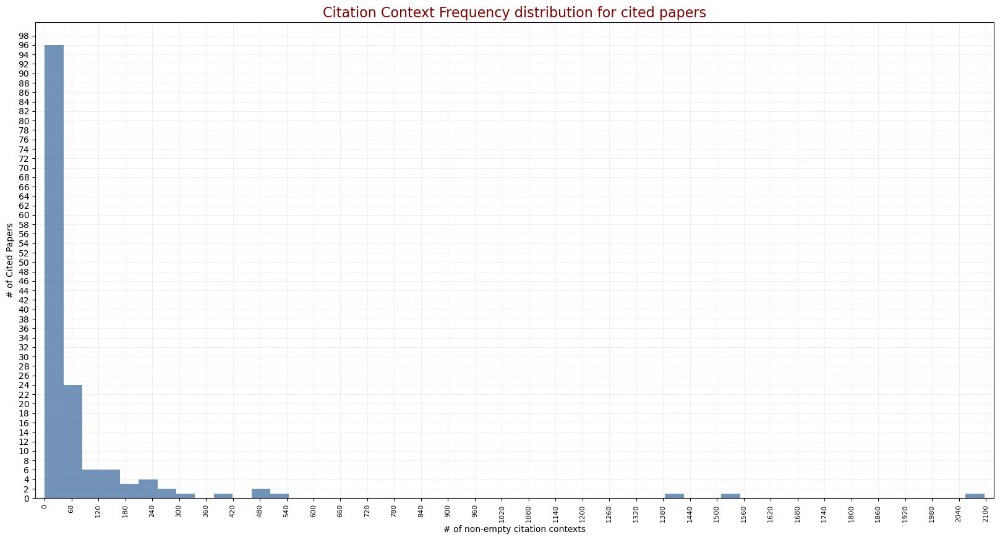

In [196]:
# Figure 002 - Frequency distribution for number of countires with different survey counts
fig = plt.figure(figsize = (20, 10))
 
x = df_excel_["valid_citation_context_count"]


print(x)

num_bins = 50

plt.xticks(np.arange(0, 3000, step=60))
plt.yticks(np.arange(0, 100, step=2))

plt.xticks(rotation=90)

plt.xlabel("# of non-empty citation contexts",fontsize=10)
plt.ylabel("# of Cited Papers",fontsize=10)
plt.title("Citation Context Frequency distribution for cited papers",fontsize=16, color='maroon')

plt.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
plt.margins(x=0.01, tight=True)

# plt.hist(x, num_bins, density=False,color=(0.2, 0.4, 0.6, 0.7),width = 1/num_bins)
plt.hist(x, num_bins,color=(0.2, 0.4, 0.6, 0.7),density=False)
plt.savefig("plots/R_001_Figure_004_Citation_Context_Frequency_distribution_for_cited_papers.png",pad_inches=1)
plt.show()

Axes(0.125,0.11;0.775x0.77)
0      57
1      38
2      15
3       6
4       6
       ..
144    28
145     0
146    59
147     2
148     2
Name: valid_citation_context_count, Length: 149, dtype: int64


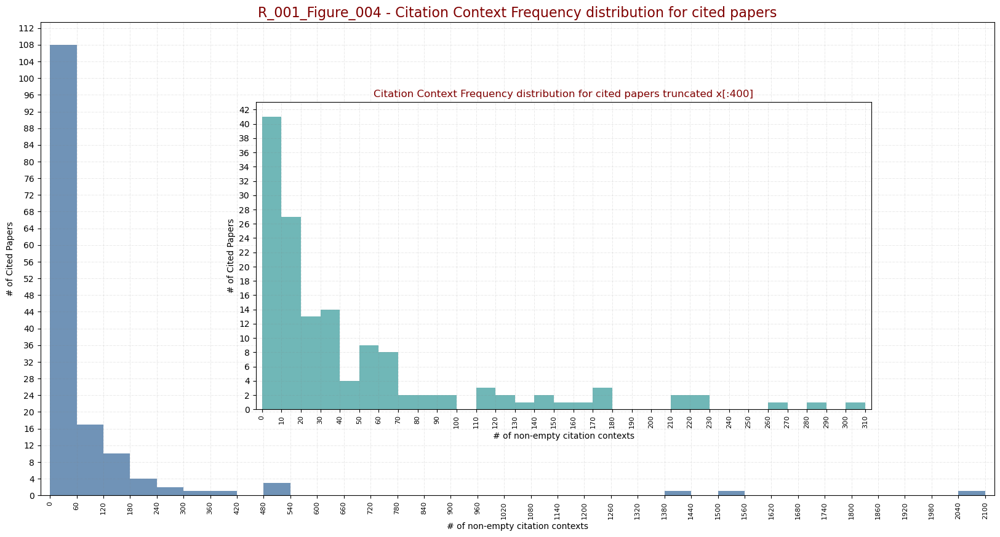

In [267]:
# Adding the inset -- Citation Context Frequency distribution for cited papers

import matplotlib.pyplot as plt

fig, ax1 = plt.subplots(figsize = (20, 10))

# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [0.3, 0.25, 0.5, 0.5]
ax2 = fig.add_axes([left, bottom, width, height])

print(ax1)
 
# x =  list(new_df['citation_count_org']) #.astype(int)

x = df_excel_["valid_citation_context_count"]

print(x)

# num_bins_1 = 49
binwidth = 60
ax1.set(xticks=np.arange(0, 3000, step=binwidth)) #, xticklabels=labels)
ax1.set(yticks=np.arange(0, 120, step=4))
ax1.tick_params(axis='x', labelrotation=90)

ax1.set_xlabel("# of non-empty citation contexts",fontsize=10)
ax1.set_ylabel("# of Cited Papers",fontsize=10)
ax1.set_title("R_001_Figure_004 - Citation Context Frequency distribution for cited papers",fontsize=16, color='maroon')

ax1.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
ax1.margins(x=0.01, tight=True)

ax1.hist(x, bins=np.arange(min(x), max(x) + binwidth, binwidth),color=(0.2, 0.4, 0.6, 0.7),density=False)



# num_bins_2 = 30
binwidth_2 = 10
x2 = [i for i in x if i<311]
ax2.set(xticks=np.arange(0, 311, step=binwidth_2)) #, xticklabels=labels)
ax2.set(yticks=np.arange(0, 100, step=2))

ax2.tick_params(axis='x', labelrotation=90)
ax2.set_xlabel("# of non-empty citation contexts",fontsize=10)
ax2.set_ylabel("# of Cited Papers",fontsize=10)
ax2.set_title("Citation Context Frequency distribution for cited papers truncated x[:400]",fontsize=12, color='maroon')

ax2.grid(color='gray', linestyle='-.', linewidth=0.4,alpha=0.3)
ax2.margins(x=0.01, tight=True)

# ax2.hist(x2, num_bins_2,color=(0.2, 0.6, 0.6, 0.7),density=False)
ax2.hist(x2, bins=np.arange(min(x2), max(x2) + binwidth_2, binwidth_2),color=(0.2, 0.6, 0.6, 0.7),density=False)

# ax1.figure.savefig("plots/R_001_Figure_003_Citation_Frequency_distribution_for_cited_papers.png",pad_inches=1)
# ax2.plot(range(6)[::-1], color='green')

plt.savefig("plots/R_001_Figure_004_Citation_Context_Frequency_distribution_for_cited_papers.png",pad_inches=1)


plt.show()

In [6]:
import math

def euclidean_distance(point1, point2):
    """
    Calculate the Euclidean distance between two points in a 2D space.

    Parameters:
    - point1: Tuple or list representing the coordinates of the first point (x1, y1).
    - point2: Tuple or list representing the coordinates of the second point (x2, y2).

    Returns:
    - Euclidean distance between the two points.
    """
    x1, y1 = point1
    x2, y2 = point2
    
    print(f"({x2} - {x1}) + ({y2} - {y1}) :",end =" ")

    distance = math.sqrt((x2 - x1)**2 + (y2 - y1)**2)
    return distance

# Example usage:
point_a = (1, 2)
point_b = (4, 6)

distance = euclidean_distance(point_a, point_b)
print(f"The Euclidean distance between {point_a} and {point_b} is: {distance}")

(4 - 1) + (6 - 2) : The Euclidean distance between (1, 2) and (4, 6) is: 5.0


In [8]:
cluster_1 = (2.375,1.625)
cluster_2 = (1,1)

print(euclidean_distance((2,2), cluster_1))
print(euclidean_distance((3,2), cluster_1))
print(euclidean_distance((1,1), cluster_1))
print(euclidean_distance((3,1), cluster_1))
print(euclidean_distance((1.5,1.5), cluster_1))

print("\n\n")

print(euclidean_distance((2,2), cluster_2))
print(euclidean_distance((3,2), cluster_2))
print(euclidean_distance((1,1), cluster_2))
print(euclidean_distance((3,1), cluster_2))
print(euclidean_distance((1.5,1.5), cluster_2))

(2.375 - 2) + (1.625 - 2) : 0.5303300858899106
(2.375 - 3) + (1.625 - 2) : 0.7288689868556626
(2.375 - 1) + (1.625 - 1) : 1.5103807466993215
(2.375 - 3) + (1.625 - 1) : 0.8838834764831844
(2.375 - 1.5) + (1.625 - 1.5) : 0.8838834764831844



(1 - 2) + (1 - 2) : 1.4142135623730951
(1 - 3) + (1 - 2) : 2.23606797749979
(1 - 1) + (1 - 1) : 0.0
(1 - 3) + (1 - 1) : 2.0
(1 - 1.5) + (1 - 1.5) : 0.7071067811865476
